In [5]:
# creating dataframe from plots across 3 days(27,28,29 may) with task id, node_timestamp, cpu utilization as columns
import pandas as pd
ids=[]
cpu_utils=[]
time=[]
for c in os.listdir('/home/ubuntu/plots_new'):
#     print(c)
    if c!='.ipynb_checkpoints':
        t=pd.read_csv('/home/ubuntu/plots_new/'+c,engine='python')
        for x in range(t.shape[0]):
            cpu_utils.append(t['utilization'][x])
            time.append(t['node_timestamp'][x])
            ids.append(c)
        

df=pd.DataFrame(columns=['id','time','value'])
df['id']=ids
df['time']=time
df['value']=cpu_utils


In [ ]:
# extract features from the raw time series using tsfresh library 
from tsfresh import extract_features
extracted_features = extract_features(df, column_id="id", column_sort="time")
from tsfresh import select_features
from tsfresh.utilities.dataframe_functions import impute
# impute missing values
x=impute(extracted_features)
x=x.reset_index()

In [ ]:
# filter out time series having mean value<1
df_reduced=x[x['value__mean']>1]

In [ ]:

# after filtering smooth the time series and store it in a dataframe and save it
import numpy
def smooth(x,window_len=11,window='hanning'):
    if window_len<3:
           return x
    s=numpy.r_[2*x[0]-x[window_len-1::-1],x,2*x[-1]-x[-1:-window_len:-1]]
    if window == 'flat': #moving average
           w=numpy.ones(window_len,'d')
    else:  
           w=eval('numpy.'+window+'(window_len)')
    y=numpy.convolve(w/w.sum(),s,mode='same')
    return y[window_len:-window_len+1]

import pandas as pd
df=pd.DataFrame(columns=['id','time','value'])
import tsfresh
import os

# t_ids=[]
# t_cpu_utils=[]
# time=[]
for c in df_reduced['id']:
#     print(c)
    if c!='.ipynb_checkpoints':
        t=pd.read_csv('/home/ubuntu/plots_new/'+c,engine='python')
        t['utilization'] = list(smooth(numpy.array(t['utilization']), 15))
        t.to_csv('./plots_smooth_less/'+c)

In [1]:
import pandas as pd
df=pd.DataFrame(columns=['id','time','value'])

In [2]:
import tsfresh
import os

In [4]:
ethos_ids=['scidxsvc-production',
'ddeventcnsumer-prod',

'stkidxs-production',
'activitylogreceiver-prod']

In [3]:
# read the saved smoothed plots into a dataframe 

ids=[]
cpu_utils=[]
time=[]
for c in os.listdir('/home/ubuntu/plots_smooth_less'):
#     print(c)
    if c!='.ipynb_checkpoints':
#        for p in ethos_ids:
#            if p in c:
        t=pd.read_csv('/home/ubuntu/plots_smooth_less/'+c,engine='python')
        for x in range(t.shape[0]):
            cpu_utils.append(t['utilization'][x])
            time.append(t['node_timestamp'][x])
            ids.append(c)


    

In [ ]:
df=pd.DataFrame(columns=['id','time','value'])
df['id']=ids
df['time']=time
df['value']=cpu_utils
# extract features using tsfresh from smoothed time series
from tsfresh import extract_features
extracted_features = extract_features(df, column_id="id", column_sort="time")

from tsfresh import select_features
from tsfresh.utilities.dataframe_functions import impute

x=impute(extracted_features)

x=x.reset_index()

In [ ]:

# function to remove correlated features above a particular threshold value 
def correlation(dataset, threshold):
    col_corr = set() # Set of all the names of deleted columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if corr_matrix.iloc[i, j] >= threshold:
                colname = corr_matrix.columns[i] # getting the name of column
                col_corr.add(colname)
                if colname in dataset.columns:
                    del dataset[colname] # deleting the column from the dataset

    return dataset

In [14]:
x1=correlation(x,0.8)

In [10]:
# normalizing the features 
from sklearn import preprocessing
val = x.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(val)
df = pd.DataFrame(x_scaled)
# df

In [11]:
X=df.as_matrix()

/home/ubuntu/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.


In [12]:
X.shape

(590, 794)

In [11]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score



In [13]:


from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from collections import defaultdict
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import StandardScaler
# class which does principal feature analysis, extracts top n_features out of the total feature set
class PFA(object):
    def __init__(self, n_features, q=None):
        self.q = q
        self.n_features = n_features

    def fit(self, X):
        if not self.q:
            self.q = X.shape[1]

        sc = StandardScaler()
        X = sc.fit_transform(X)

        pca = PCA(n_components=self.q).fit(X)
        A_q = pca.components_.T

        kmeans = KMeans(n_clusters=self.n_features).fit(A_q)
        clusters = kmeans.predict(A_q)
        cluster_centers = kmeans.cluster_centers_

        dists = defaultdict(list)
        for i, c in enumerate(clusters):
            dist = euclidean_distances([A_q[i, :]], [cluster_centers[c, :]])[0][0]
            dists[c].append((i, dist))

        self.indices_ = [sorted(f, key=lambda x: x[1])[0][0] for f in dists.values()]
        self.features_ = X[:, self.indices_]

In [89]:
# def accuracy(train_ids,train_labels,test_ids,test_labels):
#     cnt=0.
#     for idx,c in enumerate(test_labels):
        
#         if c==train_labels[train_ids.index(test_ids[idx])]:
#             cnt+=1
#     return cnt/len(test_labels)
        
        
    

In [67]:
#extracting service ids from tasks ids 
train_ids=[]
for c in extracted_features.index.tolist():
    train_ids.append(c.split('.')[0])
    

In [69]:
len(set(train_ids))

70

In [32]:
# import numpy
# def smooth(x,window_len=11,window='hanning'):
#     if window_len<3:
#            return x
#     s=numpy.r_[2*x[0]-x[window_len-1::-1],x,2*x[-1]-x[-1:-window_len:-1]]
#     if window == 'flat': #moving average
#            w=numpy.ones(window_len,'d')
#     else:  
#            w=eval('numpy.'+window+'(window_len)')
#     y=numpy.convolve(w/w.sum(),s,mode='same')
#     return y[window_len:-window_len+1]

# import pandas as pd
# df=pd.DataFrame(columns=['id','time','value'])
# import tsfresh
# import os

# t_ids=[]
# t_cpu_utils=[]
# time=[]
# for c in df_reduced['id']:
# #     print(c)
#     if c!='.ipynb_checkpoints':
#         t=pd.read_csv('/home/ubuntu/plots_new/'+c,engine='python')
#         t['utilization'] = list(smooth(numpy.array(t['utilization']), 15))
#         t.to_csv('./plots_smooth_less/'+c)

In [19]:
# import numpy as np
# #X = np.random.random((1000,1000))
# scores2 = []
# num_features=[]
# for i in range(2, 10):
#     scores = []
#     for j in range(50, 250):
#         pfa = PFA(n_features=j)
#         pfa.fit(X)

#         # To get the transformed matrix
#     #     X = pfa.features_

#         # To get the column indices of the kept features
#         column_indices = pfa.indices_
#         kmeans = KMeans(n_clusters=i).fit(X[:,column_indices])
# #        print(len(kmeans.labels_))
# #        p=kmeans.cluster_centers_
# #        print(p)
#         acc=accuracy(train_ids,list(kmeans.labels_),test_ids,list(p))
#         print('number of clusters>>',i)
#         print('top features selected>>',j)
        
# #        print('accuracy>>',acc)
#  #       scores.append(acc)
#     #        sse[i] = kmeans.inertia_
# #        silhouette_avg = silhouette_score(X[:,column_indices].reshape(-1,1), kmeans.labels_)
# #        scores.append(silhouette_avg)
#  #   scores2.append(max(scores))
#  #   num_features.append(50+scores.index(max(scores)))
    

[[0.         0.6303029  0.68632509 0.79149976 0.46365673 0.33914618
  0.55977511 0.43491532 0.04711779 0.45307726 0.01122449 0.82017507
  0.60890025 0.13191887 0.02173317 0.3469935  0.74218777 0.69642326
  0.76706928 0.7148702  0.96326531 0.66373326 0.69952032 0.40904953
  0.79383415 0.31883219 0.42857143 0.75415475 0.65920791 0.59931245
  0.74207214 0.77146996 0.53806022 0.34436353 0.72092535 0.77277333
  0.40408163 0.02967052 0.80078075 0.77819834 0.72115289 0.247699
  0.43463579 0.91346939 0.10088058 0.06138599 0.65691295 0.24489796
  0.68023135 0.8043089 ]
 [0.         0.4596691  0.56296069 0.47594548 0.45048547 0.15078898
  0.45792876 0.44457979 0.0431223  0.42424192 0.01489265 0.46369229
  0.50826771 0.10107056 0.05715837 0.43875059 0.41771785 0.59571291
  0.47313502 0.54803772 0.96811594 0.46960242 0.39662048 0.4021129
  0.46198515 0.31877982 0.54275362 0.56353131 0.55398311 0.56825721
  0.55466088 0.5314362  0.50124565 0.35251256 0.4553156  0.50614155
  0.55629291 0.05703373 0.

KeyboardInterrupt: 

In [63]:
# the function which computes accuracy of clustering based on if all the instances of a service goes to the same cluster 

def new_acc(train_ids,train_labels):
    cnt=0.
    unique_ids=list(set(train_ids))
    for c in unique_ids:
        indices=[]
        for idx,m in enumerate(train_ids):
            if m==c:
                indices.append(idx)
        if len(list(set(list(np.array(train_labels)[indices]))))==1:
            cnt+=1
#            print(c,set(list(np.array(train_labels)[indices])))
       
#            print(c,set(list(np.array(train_labels)[indices])))
    return cnt/len(unique_ids)
        

In [70]:
import numpy as np

scores2 = []
num_features=[]
# varying the number of clusters
for i in range(3,7):
    scores = []
    # varying the number of features to be used for clustering by the PFA method  
    for j in range(150, 300):
        pfa = PFA(n_features=j)
        pfa.fit(X)

   

        # To get the column indices of the kept features
        column_indices = pfa.indices_
        kmeans = KMeans(n_clusters=i).fit(X[:,column_indices])
#        print(len(kmeans.labels_))
#        p=kmeans.predict(Xt[:,column_indices])
        acc=new_acc(train_ids,list(kmeans.labels_))
        print('number of clusters>>',i)
        print('top features selected>>',j)
        
        print('accuracy>>',acc)
        scores.append(acc)
    #        sse[i] = kmeans.inertia_
#        silhouette_avg = silhouette_score(X[:,column_indices].reshape(-1,1), kmeans.labels_)
#        scores.append(silhouette_avg)
    scores2.append(max(scores))
    num_features.append(150+scores.index(max(scores)))
    

number of clusters>> 3
top features selected>> 150
accuracy>> 0.8
number of clusters>> 3
top features selected>> 151
accuracy>> 0.8
number of clusters>> 3
top features selected>> 152
accuracy>> 0.8142857142857143
number of clusters>> 3
top features selected>> 153
accuracy>> 0.8142857142857143
number of clusters>> 3
top features selected>> 154
accuracy>> 0.7857142857142857
number of clusters>> 3
top features selected>> 155
accuracy>> 0.7714285714285715
number of clusters>> 3
top features selected>> 156
accuracy>> 0.8
number of clusters>> 3
top features selected>> 157
accuracy>> 0.6857142857142857
number of clusters>> 3
top features selected>> 158
accuracy>> 0.8571428571428571
number of clusters>> 3
top features selected>> 159
accuracy>> 0.8
number of clusters>> 3
top features selected>> 160
accuracy>> 0.7571428571428571
number of clusters>> 3
top features selected>> 161
accuracy>> 0.8428571428571429
number of clusters>> 3
top features selected>> 162
accuracy>> 0.7428571428571429
number 

number of clusters>> 3
top features selected>> 254
accuracy>> 0.8714285714285714
number of clusters>> 3
top features selected>> 255
accuracy>> 0.8714285714285714
number of clusters>> 3
top features selected>> 256
accuracy>> 0.8857142857142857
number of clusters>> 3
top features selected>> 257
accuracy>> 0.8428571428571429
number of clusters>> 3
top features selected>> 258
accuracy>> 0.8571428571428571
number of clusters>> 3
top features selected>> 259
accuracy>> 0.7714285714285715
number of clusters>> 3
top features selected>> 260
accuracy>> 0.8857142857142857
number of clusters>> 3
top features selected>> 261
accuracy>> 0.8571428571428571
number of clusters>> 3
top features selected>> 262
accuracy>> 0.8285714285714286
number of clusters>> 3
top features selected>> 263
accuracy>> 0.8142857142857143
number of clusters>> 3
top features selected>> 264
accuracy>> 0.7857142857142857
number of clusters>> 3
top features selected>> 265
accuracy>> 0.8857142857142857
number of clusters>> 3
top f

number of clusters>> 4
top features selected>> 208
accuracy>> 0.8571428571428571
number of clusters>> 4
top features selected>> 209
accuracy>> 0.7714285714285715
number of clusters>> 4
top features selected>> 210
accuracy>> 0.8428571428571429
number of clusters>> 4
top features selected>> 211
accuracy>> 0.7571428571428571
number of clusters>> 4
top features selected>> 212
accuracy>> 0.7142857142857143
number of clusters>> 4
top features selected>> 213
accuracy>> 0.7571428571428571
number of clusters>> 4
top features selected>> 214
accuracy>> 0.7857142857142857
number of clusters>> 4
top features selected>> 215
accuracy>> 0.7714285714285715
number of clusters>> 4
top features selected>> 216
accuracy>> 0.8571428571428571
number of clusters>> 4
top features selected>> 217
accuracy>> 0.7
number of clusters>> 4
top features selected>> 218
accuracy>> 0.7571428571428571
number of clusters>> 4
top features selected>> 219
accuracy>> 0.8
number of clusters>> 4
top features selected>> 220
accurac

number of clusters>> 5
top features selected>> 162
accuracy>> 0.8142857142857143
number of clusters>> 5
top features selected>> 163
accuracy>> 0.6285714285714286
number of clusters>> 5
top features selected>> 164
accuracy>> 0.7
number of clusters>> 5
top features selected>> 165
accuracy>> 0.7428571428571429
number of clusters>> 5
top features selected>> 166
accuracy>> 0.6714285714285714
number of clusters>> 5
top features selected>> 167
accuracy>> 0.7857142857142857
number of clusters>> 5
top features selected>> 168
accuracy>> 0.6428571428571429
number of clusters>> 5
top features selected>> 169
accuracy>> 0.6571428571428571
number of clusters>> 5
top features selected>> 170
accuracy>> 0.5571428571428572
number of clusters>> 5
top features selected>> 171
accuracy>> 0.6571428571428571
number of clusters>> 5
top features selected>> 172
accuracy>> 0.7285714285714285
number of clusters>> 5
top features selected>> 173
accuracy>> 0.7428571428571429
number of clusters>> 5
top features selecte

number of clusters>> 5
top features selected>> 266
accuracy>> 0.6714285714285714
number of clusters>> 5
top features selected>> 267
accuracy>> 0.7
number of clusters>> 5
top features selected>> 268
accuracy>> 0.8428571428571429
number of clusters>> 5
top features selected>> 269
accuracy>> 0.6857142857142857
number of clusters>> 5
top features selected>> 270
accuracy>> 0.7
number of clusters>> 5
top features selected>> 271
accuracy>> 0.8142857142857143
number of clusters>> 5
top features selected>> 272
accuracy>> 0.7428571428571429
number of clusters>> 5
top features selected>> 273
accuracy>> 0.8
number of clusters>> 5
top features selected>> 274
accuracy>> 0.8285714285714286
number of clusters>> 5
top features selected>> 275
accuracy>> 0.7571428571428571
number of clusters>> 5
top features selected>> 276
accuracy>> 0.8
number of clusters>> 5
top features selected>> 277
accuracy>> 0.8142857142857143
number of clusters>> 5
top features selected>> 278
accuracy>> 0.7571428571428571
number 

number of clusters>> 6
top features selected>> 219
accuracy>> 0.7142857142857143
number of clusters>> 6
top features selected>> 220
accuracy>> 0.6428571428571429
number of clusters>> 6
top features selected>> 221
accuracy>> 0.7
number of clusters>> 6
top features selected>> 222
accuracy>> 0.7857142857142857
number of clusters>> 6
top features selected>> 223
accuracy>> 0.7285714285714285
number of clusters>> 6
top features selected>> 224
accuracy>> 0.7571428571428571
number of clusters>> 6
top features selected>> 225
accuracy>> 0.6571428571428571
number of clusters>> 6
top features selected>> 226
accuracy>> 0.6142857142857143
number of clusters>> 6
top features selected>> 227
accuracy>> 0.6
number of clusters>> 6
top features selected>> 228
accuracy>> 0.7142857142857143
number of clusters>> 6
top features selected>> 229
accuracy>> 0.6571428571428571
number of clusters>> 6
top features selected>> 230
accuracy>> 0.6285714285714286
number of clusters>> 6
top features selected>> 231
accurac

In [20]:
# import numpy as np
# sse = {}
# # for i in range(2,20):

# S = []
# scores = []
# for j in range(X.shape[1]):
#     if np.unique(X[:,j]).shape[0]==1:
#         continue

#     kmeans = KMeans(n_clusters=i, random_state=0).fit(X[:,j].reshape(-1,1))
# #        sse[i] = kmeans.inertia_
#     silhouette_avg = silhouette_score(X[:,j].reshape(-1,1), kmeans.labels_)
#     scores.append(silhouette_)
#     print(i,j,kmeans.labels_,np.unique(np.array(kmeans.labels_)).shape,silhouette_avg)
# #%matplotlib inline
# #import matplotlib.pyplot as plt
# #plt.plot(list(sse.keys()), list(sse.values()))
# #plt.show()

NameError: name 'silhouette_' is not defined

In [ ]:
def new_acc(train_ids,train_labels):
    cnt=0.
    unique_ids=list(set(train_ids))
    for c in unique_ids:
        indices=[]
        for idx,m in enumerate(train_ids):
            if m==c:
                indices.append(idx)
        if len(list(set(list(np.array(train_labels)[indices]))))==1:
            cnt+=1
            print(c,set(list(np.array(train_labels)[indices])))
        else:
       
            print(c,set(list(np.array(train_labels)[indices])))
            print()
    return cnt/len(unique_ids)
        

In [74]:
import numpy as np

scores2 = []
num_features=[]
# suppose we take clusters=4
for i in range(4,5):
    scores = []
    # choose features=202 which gave max accuracy 
    for j in range(202,203):
        pfa = PFA(n_features=j)
        pfa.fit(X)

        # To get the transformed matrix
    #     X = pfa.features_

        # To get the column indices of the kept features
        column_indices = pfa.indices_
        kmeans = KMeans(n_clusters=i).fit(X[:,column_indices])
#        print(len(kmeans.labels_))
#        p=kmeans.predict(Xt[:,column_indices])
        acc=new_acc(train_ids,list(kmeans.labels_))
        print('number of clusters>>',i)
        print('top features selected>>',j)
        
        print('accuracy>>',acc)
        scores.append(acc)
    #        sse[i] = kmeans.inertia_
#        silhouette_avg = silhouette_score(X[:,column_indices].reshape(-1,1), kmeans.labels_)
#        scores.append(silhouette_avg)
#    scores2.append(max(scores))
 #   num_features.append(150+scores.index(max(scores)))
    

casfeaturestock7-prod-30df27e2ef {1}
ethosha-production3-fb2c0465c9 {1}
sellableitems-prod-fa8b019fbf {1}
cupmat-production-632b434acd {1}
tsreport-prod-a4c944e2ae {1}
ethosha-production2-e1990b23d6 {1}
ethosha-production1-e06e9e0060 {1}
enterorgservice-prod-6f99c19a45 {1}
materialsservice-prod-9d558d95f4 {1}
apex-production-eee88bd80a {2}
moveworker-production-87ea3d96de {1}
uss-prod-105178c1ac {2}
copyworker-production-dab2f3f0af {1}
storybackupworker-production-75848d087d {0, 1}
sophiacepservice-prod-0c6f493a8c {2}
cclibraries-production-67331e1323 {1, 2}
casfeaturestock3-prod-7c7d26425b {1}
casclassifiercopyspace-prod-53401db761 {1}
storybackupworker-preprod-edb529cad7 {1}
translator-production-2761721ab4 {2}
tslogger-prod-028e645d88 {1}
uss-prod-cb44f20d2c {1, 2}
uss-prod2-c23944d098 {2}
tsnormalizer-prod-2c19446dad {1}
ethosha-production2-c343a08d41 {1}
casfeatureaesthetic-prod-f505e14c13 {1}
ethosha-production1-49f2add162 {1}
products-prod-e2f5d9c6a9 {1}
ethosha-production2-52f0

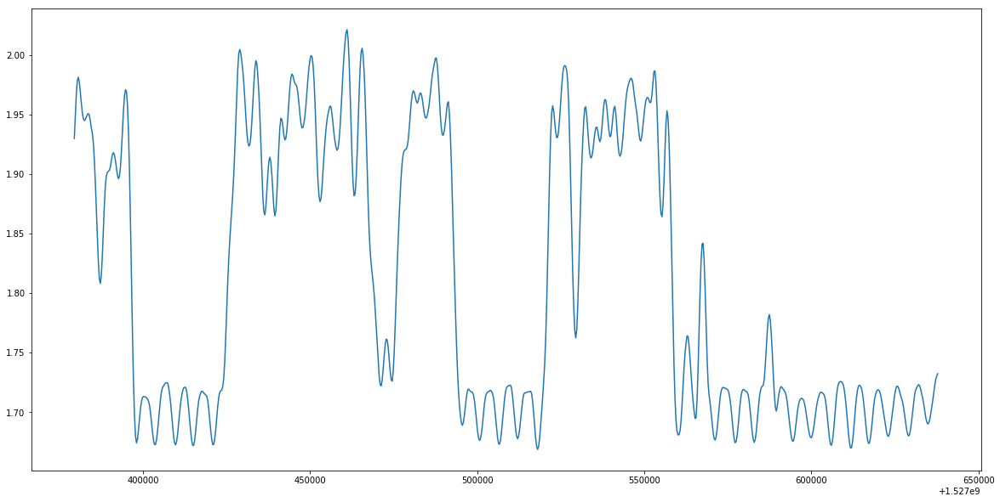

In [87]:
import  pandas as pd
import os
t=pd.read_csv('/home/ubuntu/plots_smooth_less/storybackupworker-production-75848d087d.storybackupworker---32b03c6bfe841b4d5d3c95858c1efc608f047092----0f7339.ae4b3749-5dec-11e8-8cc3-8230a943a1c1.csv')


%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t['node_timestamp'],t['utilization'])
plt.show()

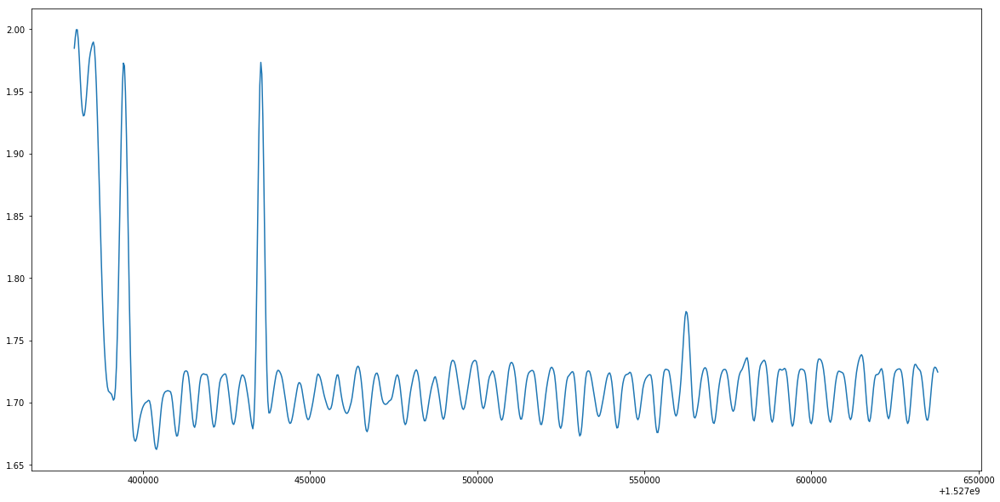

In [88]:
import  pandas as pd
import os
t=pd.read_csv('/home/ubuntu/plots_smooth_less/storybackupworker-production-75848d087d.storybackupworker---32b03c6bfe841b4d5d3c95858c1efc608f047092----0f7339.ae4bd38c-5dec-11e8-8cc3-8230a943a1c1.csv')


%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.plot(t['node_timestamp'],t['utilization'])
plt.show()

In [89]:
y=extracted_features.reset_index()
y

variable,id,value__abs_energy,value__absolute_sum_of_changes,"value__agg_autocorrelation__f_agg_""mean""","value__agg_autocorrelation__f_agg_""median""","value__agg_autocorrelation__f_agg_""var""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""intercept""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""rvalue""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""slope""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""stderr""",...,value__time_reversal_asymmetry_statistic__lag_2,value__time_reversal_asymmetry_statistic__lag_3,value__value_count__value_-inf,value__value_count__value_0,value__value_count__value_1,value__value_count__value_inf,value__value_count__value_nan,value__variance,value__variance_larger_than_standard_deviation,cluster
0,activitylogconsumer-prod-fd12043401.activityco...,6.241347e+04,61.777481,0.600599,0.549624,0.034604,8.116834,0.403031,0.013778,0.003394,...,0.298038,0.693942,0.0,0.0,0.0,0.0,0.0,0.785212,0.0,1
1,activitylogconsumer-prod-fd12043401.activityco...,6.461060e+04,63.273410,0.661264,0.653874,0.030700,8.175457,0.434881,0.016177,0.003633,...,0.610585,0.721542,0.0,0.0,0.0,0.0,0.0,0.900148,0.0,1
2,activitylogconsumer-prod-fd12043401.activityco...,2.986792e+04,64.042654,0.418392,0.332403,0.037402,5.796870,0.421831,0.007859,0.001832,...,0.571269,0.750829,0.0,0.0,0.0,0.0,0.0,0.334585,0.0,1
3,activitylogreceiver-prod-0bacf0ebf9.activitylo...,1.221523e+06,375.041537,0.569054,0.480802,0.039106,41.268670,-0.183776,-0.060972,0.035373,...,55.378918,75.739040,0.0,0.0,0.0,0.0,0.0,56.952861,1.0,1
4,activitylogreceiver-prod-0bacf0ebf9.activitylo...,9.378529e+05,274.632813,0.526917,0.412001,0.046643,43.638587,-0.200638,-0.098079,0.062882,...,64.667485,97.494293,0.0,0.0,0.0,0.0,0.0,62.047835,1.0,1
5,activitylogreceiver-prod-0bacf0ebf9.csv,9.378529e+05,274.632813,0.526917,0.412001,0.046643,43.638587,-0.200638,-0.098079,0.062882,...,64.667485,97.494293,0.0,0.0,0.0,0.0,0.0,62.047835,1.0,1
6,aos-production-83687b3fbc.aos---879dafc79d084a...,2.661021e+04,142.235909,0.623099,0.593099,0.038699,2.923649,0.566344,0.061968,0.009781,...,0.526441,1.038856,0.0,0.0,0.0,0.0,0.0,6.815087,1.0,1
7,aos-production-83687b3fbc.aos---879dafc79d084a...,2.795413e+04,140.192989,0.672869,0.652268,0.028265,3.478661,0.498491,0.052988,0.009995,...,0.604511,1.286271,0.0,0.0,0.0,0.0,0.0,6.409923,1.0,1
8,apex-production-eee88bd80a.apex---aefe9bffeb83...,2.086937e+06,788.402202,0.838713,0.839751,0.011598,10.298677,0.608194,0.755317,0.106926,...,84.147612,118.996143,0.0,0.0,0.0,0.0,0.0,871.391860,1.0,2
9,apex-production-eee88bd80a.apex---aefe9bffeb83...,2.089019e+06,748.863655,0.841240,0.844688,0.011933,10.395070,0.607680,0.754027,0.106886,...,86.056829,117.229949,0.0,0.0,0.0,0.0,0.0,865.189685,1.0,2


In [ ]:
# appending the cluster labels as a column to the extracted features from tsfresh 
y['cluster']=kmeans.labels_.tolist()

In [90]:
# sorting based on cluster labels
y=y.sort_values('cluster')

y=y.reset_index()


In [91]:
y

variable,index,id,value__abs_energy,value__absolute_sum_of_changes,"value__agg_autocorrelation__f_agg_""mean""","value__agg_autocorrelation__f_agg_""median""","value__agg_autocorrelation__f_agg_""var""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""intercept""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""rvalue""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""slope""",...,value__time_reversal_asymmetry_statistic__lag_2,value__time_reversal_asymmetry_statistic__lag_3,value__value_count__value_-inf,value__value_count__value_0,value__value_count__value_1,value__value_count__value_inf,value__value_count__value_nan,value__variance,value__variance_larger_than_standard_deviation,cluster
0,429,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,43690.965149,60.786655,0.840141,0.824782,0.006053,3.781430,0.528389,0.066729,...,-0.133969,-0.240875,0.0,0.0,0.0,0.0,0.0,10.473422,1.0,0
1,435,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,53499.406979,71.793613,0.843411,0.830996,0.005663,4.205138,0.527333,0.073972,...,0.052850,0.017112,0.0,0.0,0.0,0.0,0.0,12.823724,1.0,0
2,436,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,48067.060974,69.304941,0.837988,0.824463,0.006184,4.041930,0.521880,0.068943,...,0.194458,0.177258,0.0,0.0,0.0,0.0,0.0,11.408993,1.0,0
3,437,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,53180.124989,68.810177,0.837046,0.821713,0.006280,4.314266,0.509860,0.070749,...,-0.254122,-0.510733,0.0,0.0,0.0,0.0,0.0,12.586844,1.0,0
4,438,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,43458.754780,64.111792,0.852398,0.840302,0.004982,3.526430,0.568302,0.072333,...,0.228117,0.331621,0.0,0.0,0.0,0.0,0.0,10.565535,1.0,0
5,439,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,47087.366890,70.058610,0.830460,0.812099,0.007014,4.062381,0.505475,0.066528,...,0.267992,0.245792,0.0,0.0,0.0,0.0,0.0,11.291040,1.0,0
6,440,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,43916.563178,64.150796,0.851681,0.840993,0.005011,3.343093,0.597337,0.077372,...,0.923675,1.246345,0.0,0.0,0.0,0.0,0.0,10.812285,1.0,0
7,441,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,51840.068486,71.274927,0.843840,0.827414,0.005699,4.143774,0.524265,0.072371,...,-0.373412,-0.610354,0.0,0.0,0.0,0.0,0.0,12.477978,1.0,0
8,442,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,45123.995405,65.717755,0.849283,0.837156,0.005833,4.237999,0.451700,0.058405,...,-0.564505,-1.121741,0.0,0.0,0.0,0.0,0.0,10.930425,1.0,0
9,443,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,40820.750408,59.212967,0.839735,0.828006,0.006446,4.174986,0.430739,0.052535,...,-0.869140,-1.306620,0.0,0.0,0.0,0.0,0.0,9.729113,1.0,0


In [105]:
# finding unique service ids including production(. split)
unique_ids=np.unique(np.array(y['id'].apply(lambda x:x.split('.')[0]))).tolist()

In [119]:
# finding first index of the unique service ids
idx_list=[]
for c in unique_ids:
    idx_list.append(y[y['id'].apply(lambda x:x.split('.')[0])==c].index.tolist()[0])

In [127]:
y[y['cluster']==3]['id'].unique()

array(['lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.145f9c4e-5f76-11e8-a239-421db0942d0d.csv',
       'lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.6055df5f-605f-11e8-a239-421db0942d0d.csv',
       'lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.39f62255-5fa3-11e8-a239-421db0942d0d.csv',
       'lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.3d918d24-5f88-11e8-a239-421db0942d0d.csv',
       'lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.39f5d431-5fa3-11e8-a239-421db0942d0d.csv',
       'lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.4591c96f-5f4e-11e8-a239-421db0942d0d.csv',
       'lridxsvc-production-94333b4209.lridx---207a8ec7f8378dd28d301c08e511a910e04da7ce----18c0d6.90f95e82-5e7b-11e8-a239-421db0942d0d.csv',
       'lridx

In [121]:
# reduced dataframe containing unique service ids
y_reduced=y.iloc[idx_list,:]
y_reduced

variable,index,id,value__abs_energy,value__absolute_sum_of_changes,"value__agg_autocorrelation__f_agg_""mean""","value__agg_autocorrelation__f_agg_""median""","value__agg_autocorrelation__f_agg_""var""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""intercept""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""rvalue""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""slope""",...,value__time_reversal_asymmetry_statistic__lag_2,value__time_reversal_asymmetry_statistic__lag_3,value__value_count__value_-inf,value__value_count__value_0,value__value_count__value_1,value__value_count__value_inf,value__value_count__value_nan,value__variance,value__variance_larger_than_standard_deviation,cluster
78,0,activitylogconsumer-prod-fd12043401.activityco...,6.241347e+04,61.777481,0.600599,0.549624,0.034604,8.116834,0.403031,0.013778,...,0.298038,0.693942,0.0,0.0,0.0,0.0,0.0,0.785212,0.0,1
275,5,activitylogreceiver-prod-0bacf0ebf9.csv,9.378529e+05,274.632813,0.526917,0.412001,0.046643,43.638587,-0.200638,-0.098079,...,64.667485,97.494293,0.0,0.0,0.0,0.0,0.0,62.047835,1.0,1
273,7,aos-production-83687b3fbc.aos---879dafc79d084a...,2.795413e+04,140.192989,0.672869,0.652268,0.028265,3.478661,0.498491,0.052988,...,0.604511,1.286271,0.0,0.0,0.0,0.0,0.0,6.409923,1.0,1
352,9,apex-production-eee88bd80a.apex---aefe9bffeb83...,2.089019e+06,748.863655,0.841240,0.844688,0.011933,10.395070,0.607680,0.754027,...,86.056829,117.229949,0.0,0.0,0.0,0.0,0.0,865.189685,1.0,2
272,10,archivalworker-production-184dd1cf88.cont---37...,1.781329e+03,3.592253,0.072801,0.067759,0.094138,1.457169,-0.124860,-0.000129,...,-0.002128,-0.002347,0.0,0.0,0.0,0.0,0.0,0.000575,0.0,1
271,12,asradmin-production-beefcae400.asr-admin-cont-...,1.797267e+04,41.490455,0.901960,0.902752,0.003375,2.436487,0.254986,0.030064,...,0.636949,0.952922,0.0,0.0,0.0,0.0,0.0,8.376837,1.0,1
343,21,assets-production-3d37a9b1a1.assets---981f12d9...,4.096647e+03,20.035306,0.821481,0.840691,0.018305,1.882505,0.050706,0.002235,...,0.000379,0.000326,0.0,0.0,0.0,0.0,0.0,1.191984,1.0,2
260,31,casclassifiercopyspace-prod-53401db761.contain...,6.134059e+05,344.234266,0.734759,0.741277,0.023703,24.109900,0.274820,0.074582,...,18.895690,20.214655,0.0,0.0,0.0,0.0,0.0,47.727228,1.0,1
283,35,casfeatureaesthetic-prod-1ddb1ab615.container1...,1.302303e+03,16.561346,0.732291,0.738557,0.023117,1.100827,0.278487,0.003630,...,0.001974,0.002426,0.0,0.0,0.0,0.0,0.0,0.112019,0.0,1
284,55,casfeatureaesthetic-prod-f505e14c13.container1...,2.057754e+03,11.920298,0.763518,0.761976,0.019859,1.463309,0.213908,0.002561,...,0.003580,0.005091,0.0,0.0,0.0,0.0,0.0,0.078829,0.0,1


In [122]:
y_reduced=y_reduced.sort_values('cluster')

y_reduced=y_reduced.reset_index()
y_reduced

variable,level_0,index,id,value__abs_energy,value__absolute_sum_of_changes,"value__agg_autocorrelation__f_agg_""mean""","value__agg_autocorrelation__f_agg_""median""","value__agg_autocorrelation__f_agg_""var""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""intercept""","value__agg_linear_trend__f_agg_""max""__chunk_len_10__attr_""rvalue""",...,value__time_reversal_asymmetry_statistic__lag_2,value__time_reversal_asymmetry_statistic__lag_3,value__value_count__value_-inf,value__value_count__value_0,value__value_count__value_1,value__value_count__value_inf,value__value_count__value_nan,value__variance,value__variance_larger_than_standard_deviation,cluster
0,0,429,tps-prod-2d4e5b3fe2.tps---66893b06de7a86adcc19...,4.369097e+04,60.786655,0.840141,0.824782,0.006053,3.781430,0.528389,...,-0.133969,-0.240875,0.0,0.0,0.0,0.0,0.0,10.473422,1.0,0
1,27,408,storybackupworker-production-75848d087d.storyb...,2.721889e+03,6.747212,0.746010,0.745032,0.008780,1.891322,-0.465625,...,-0.005607,-0.008892,0.0,0.0,0.0,0.0,0.0,0.010847,0.0,0
2,78,0,activitylogconsumer-prod-fd12043401.activityco...,6.241347e+04,61.777481,0.600599,0.549624,0.034604,8.116834,0.403031,...,0.298038,0.693942,0.0,0.0,0.0,0.0,0.0,0.785212,0.0,1
3,147,542,uss-prod-cb44f20d2c.uss---ba6c765721ca69818216...,1.345309e+04,23.317408,0.665882,0.617917,0.028443,3.743064,0.326691,...,-0.609288,-0.795284,0.0,0.0,0.0,0.0,0.0,2.175294,1.0,1
4,80,231,offers-prod-c9383f05ee.offers---cb3b2578e23aaa...,4.573830e+06,2084.345256,0.063216,-0.035305,0.382896,82.227305,-0.041565,...,279.987929,452.406663,0.0,0.0,0.0,0.0,0.0,196.788817,1.0,1
5,101,235,pgc-prod-2e539d7dca.pgc-worker---00377a41d8fac...,4.331018e+04,166.002612,0.603288,0.591034,0.040531,2.101517,0.538243,...,-0.148218,-0.282162,0.0,0.0,0.0,0.0,0.0,15.984083,1.0,1
6,102,237,products-prod-45ce05257f.products---f5824001d3...,5.573869e+06,2065.055113,0.095006,0.037477,0.363334,89.064366,-0.003668,...,-842.845598,-660.899758,0.0,0.0,0.0,0.0,0.0,163.005765,1.0,1
7,105,254,products-prod-e2f5d9c6a9.products---f5824001d3...,7.681074e+06,231.850469,0.592363,0.605632,0.016363,93.716165,0.532376,...,528.443043,738.844757,0.0,0.0,0.0,0.0,0.0,4.053493,1.0,1
8,104,255,purgeworker-production-0cfb6398f7.cont---9e728...,1.786324e+03,4.787502,0.066397,0.029326,0.083369,1.456907,0.093086,...,0.002078,0.002224,0.0,0.0,0.0,0.0,0.0,0.000749,0.0,1
9,40,258,quotaservice-production-55c3bfa146.quotaservic...,2.417216e+05,109.222067,0.599268,0.573061,0.018381,15.764422,0.594639,...,11.595933,14.447187,0.0,0.0,0.0,0.0,0.0,1.785218,1.0,1


tps-prod-2d4e5b3fe2
Cluster Label 0


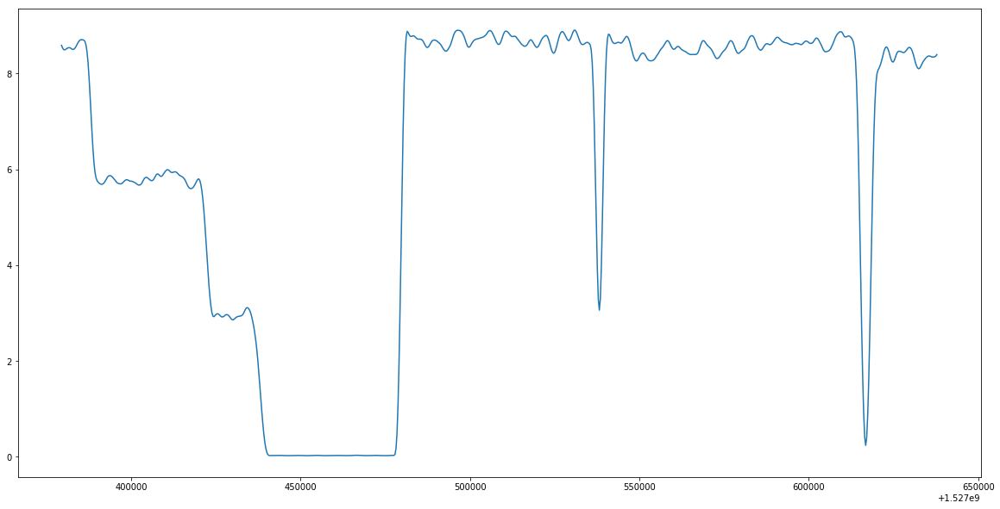

storybackupworker-production-75848d087d
Cluster Label 0


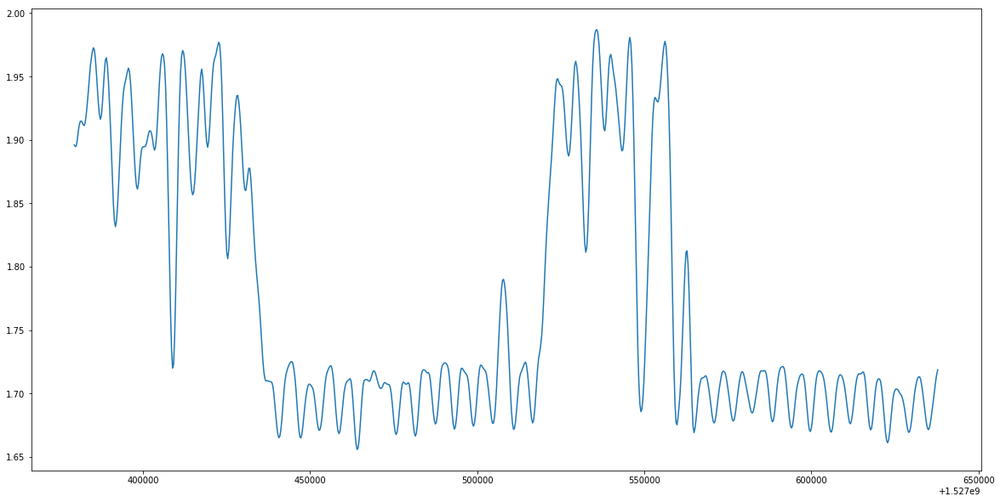

activitylogconsumer-prod-fd12043401
Cluster Label 1


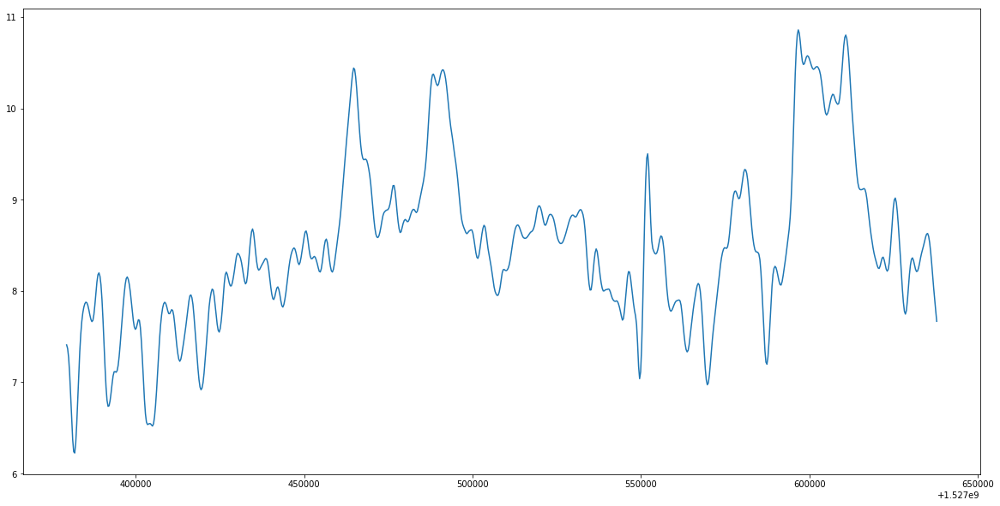

uss-prod-cb44f20d2c
Cluster Label 1


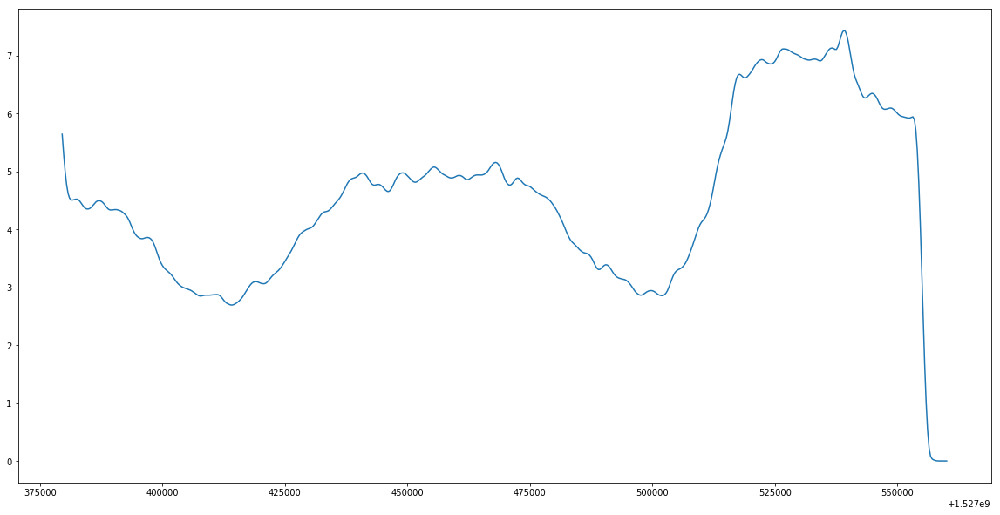

offers-prod-c9383f05ee
Cluster Label 1


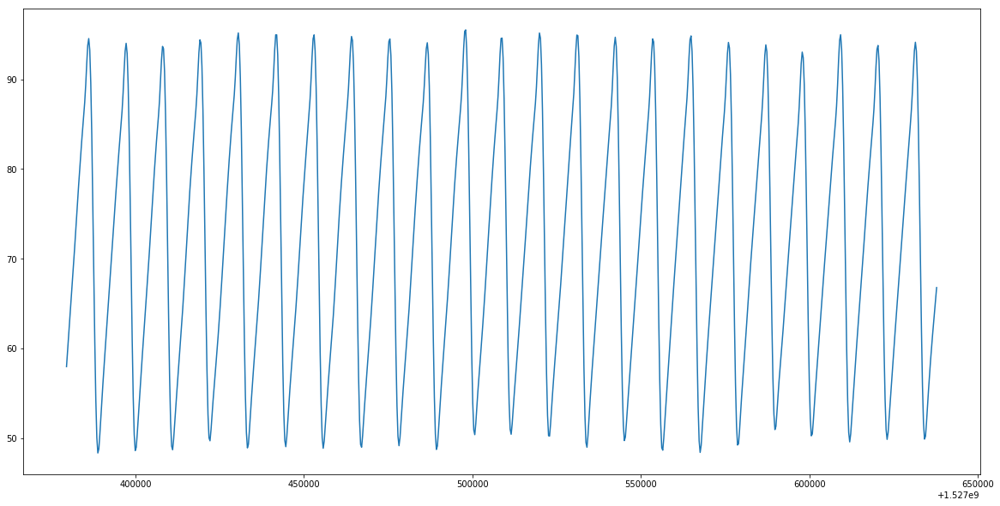

pgc-prod-2e539d7dca
Cluster Label 1


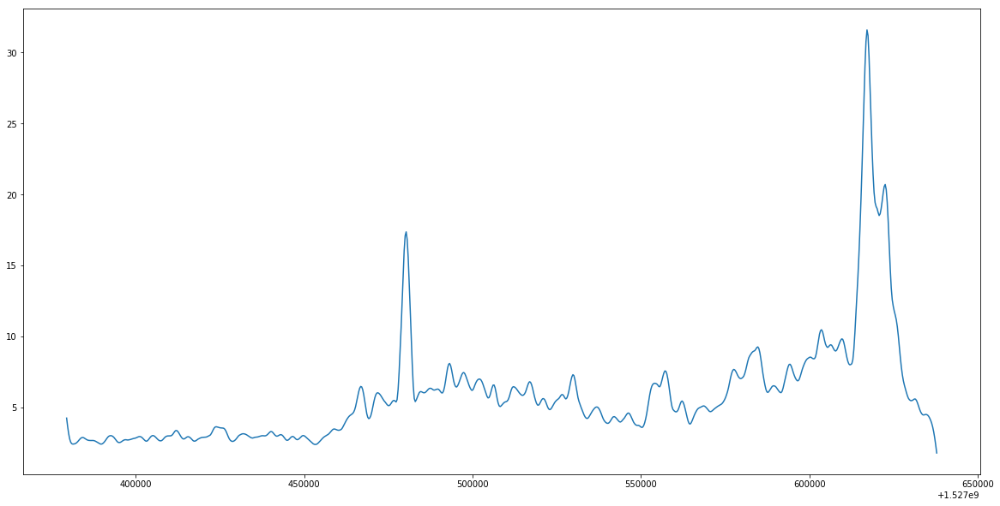

products-prod-45ce05257f
Cluster Label 1


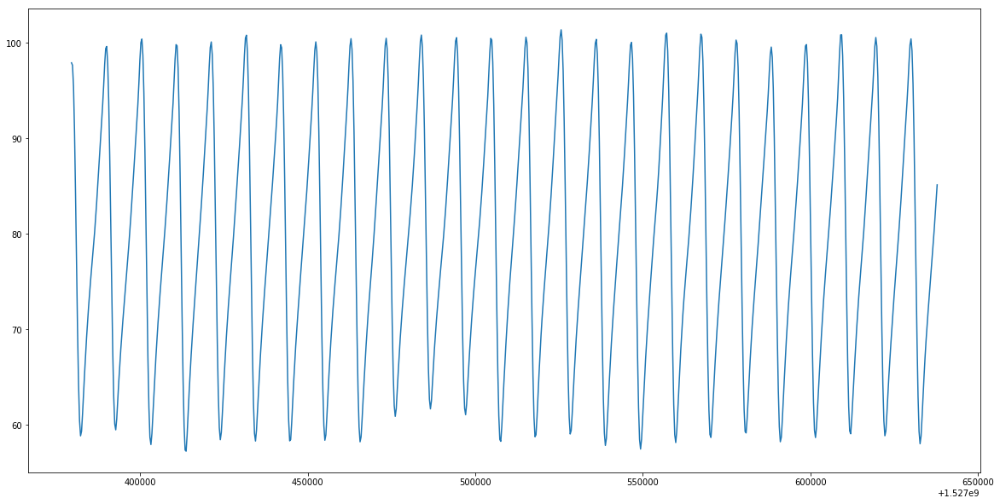

products-prod-e2f5d9c6a9
Cluster Label 1


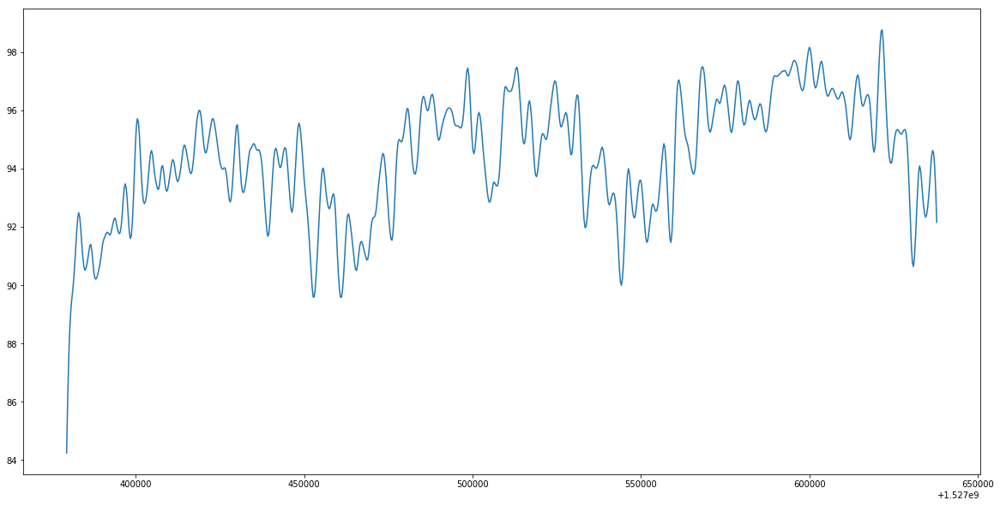

purgeworker-production-0cfb6398f7
Cluster Label 1


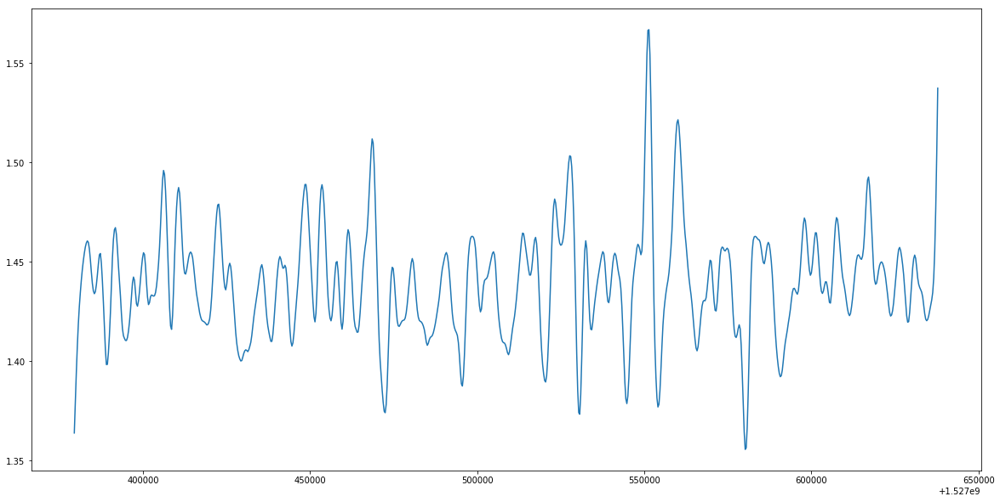

quotaservice-production-55c3bfa146
Cluster Label 1


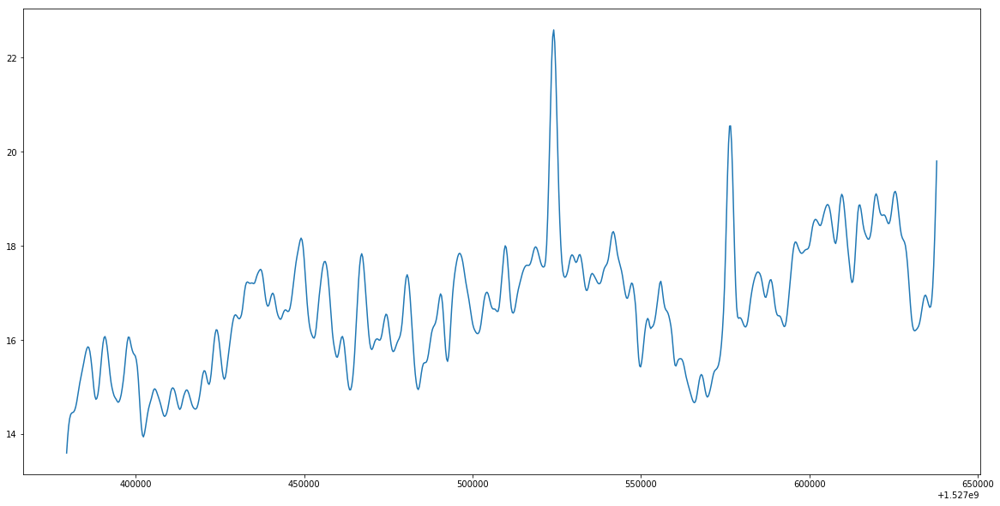

safereceiver-prod-6cf1ccb315
Cluster Label 1


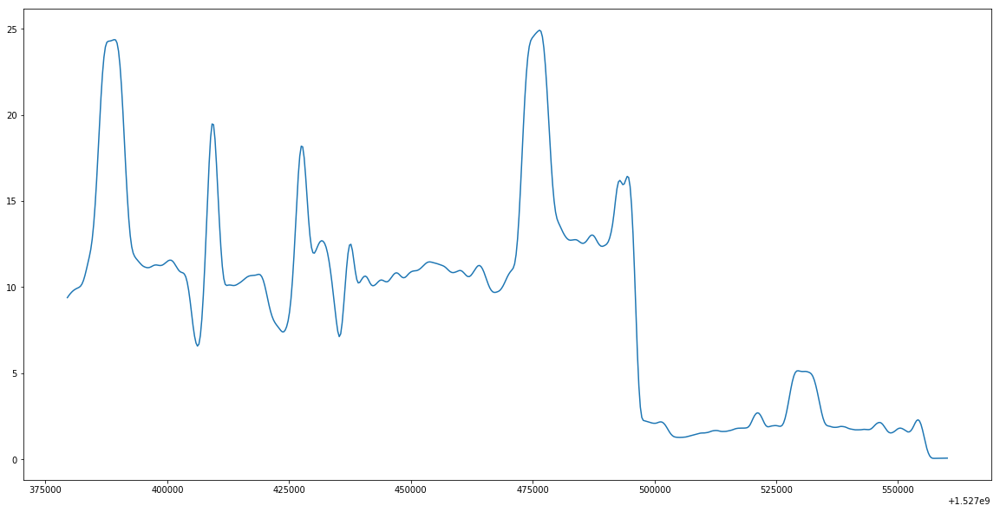

scidxsvc-production-7cf236fb63
Cluster Label 1


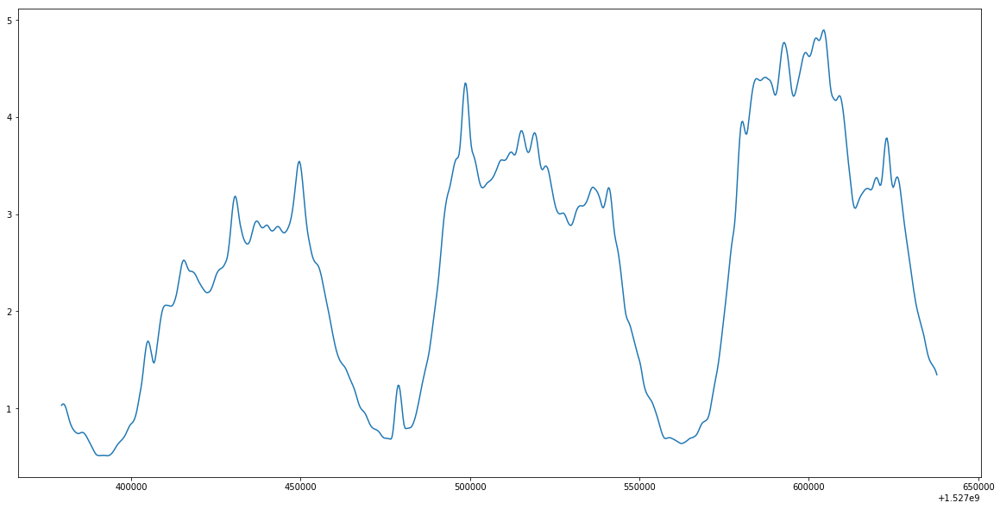

scidxsvc-production-e883fb75d4
Cluster Label 1


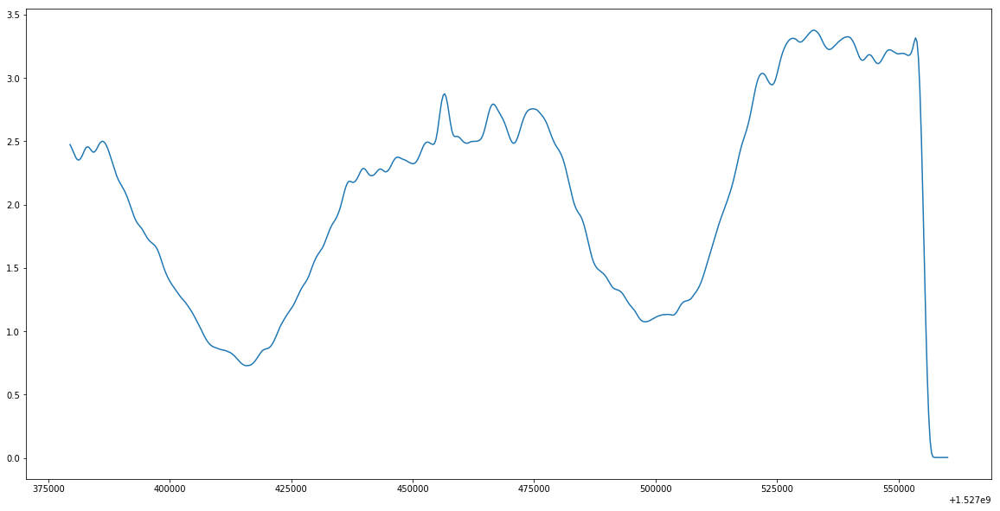

sellableitems-prod-83f90f7951
Cluster Label 1


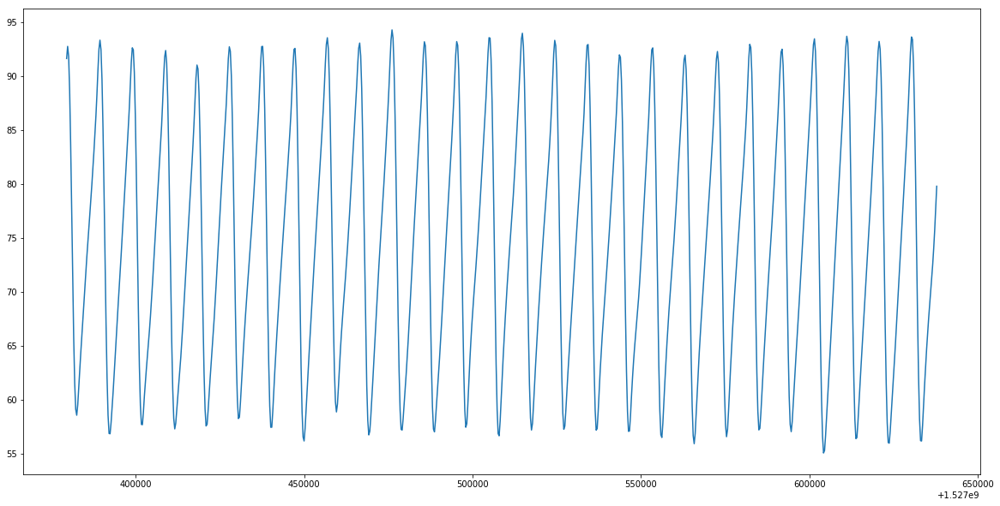

sellableitems-prod-fa8b019fbf
Cluster Label 1


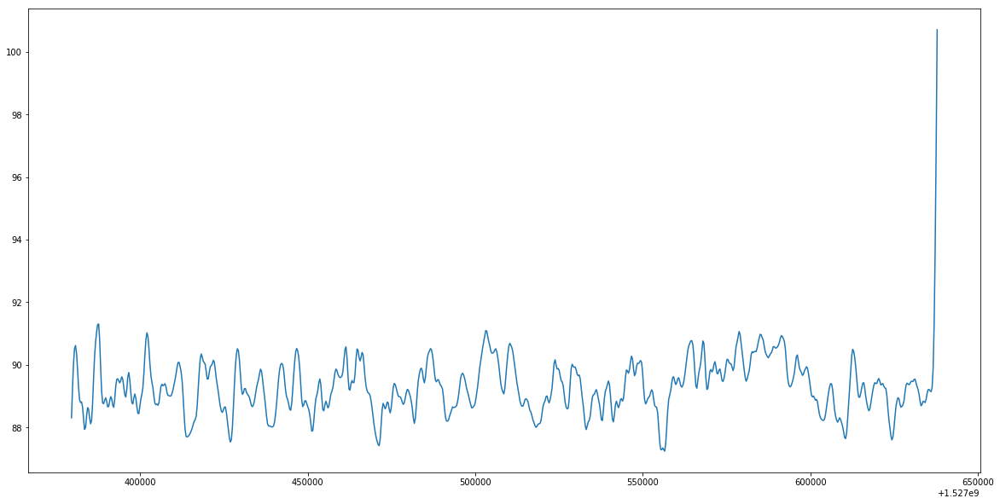

senseifeaturefacedescriptor-prod-e2f33acc40
Cluster Label 1


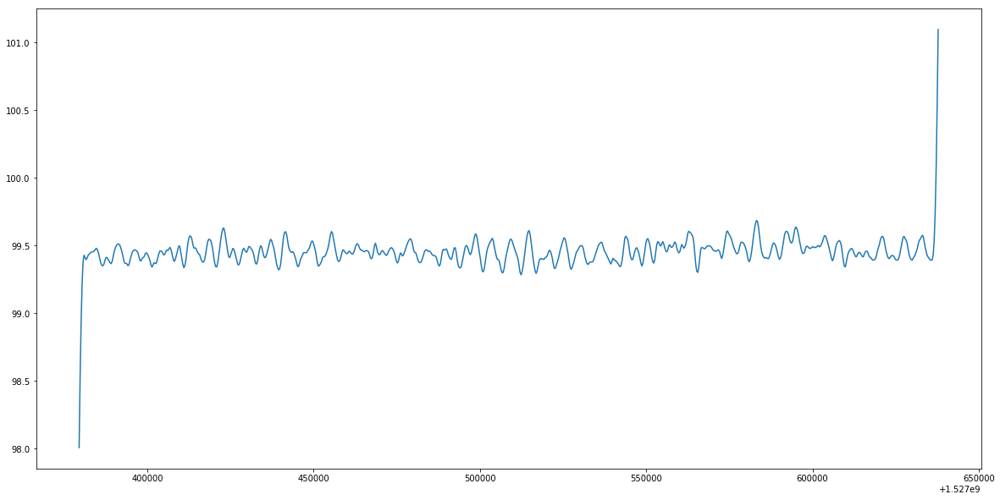

storybackupworker-dev-99eb3ea3d8
Cluster Label 1


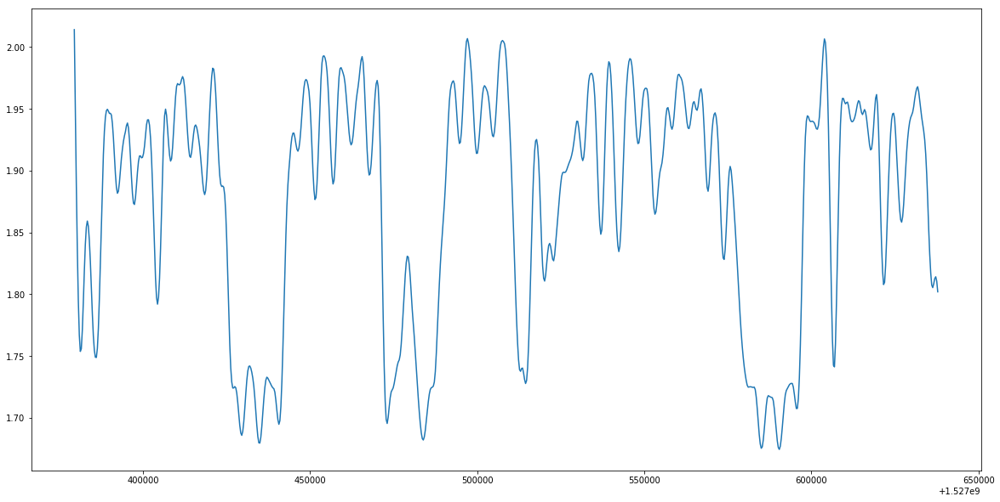

storybackupworker-dev-ce61a6511a
Cluster Label 1


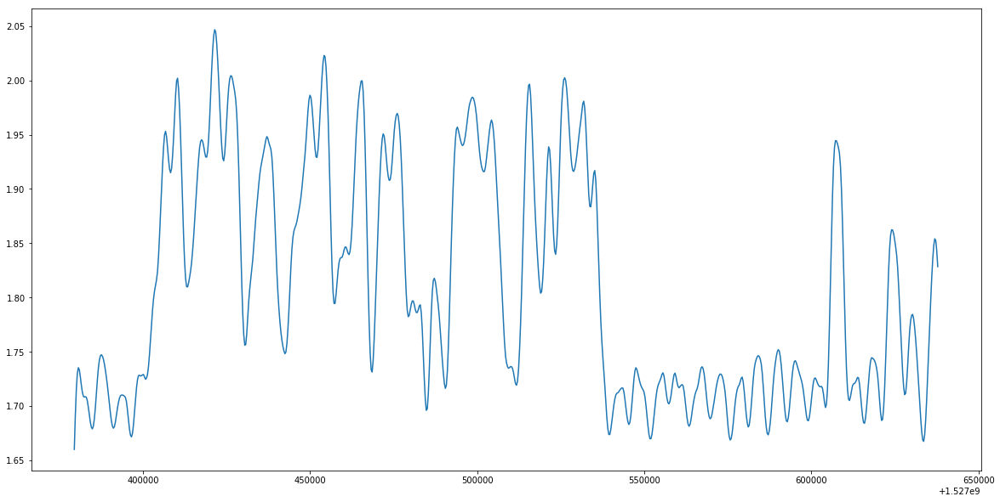

storybackupworker-dev-f0b5306f7d
Cluster Label 1


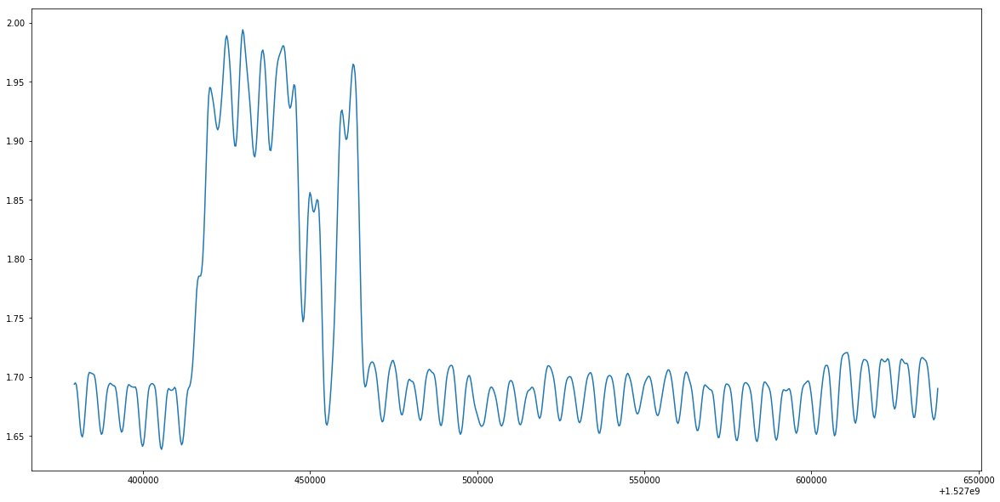

storybackupworker-preprod-3e1cd5ba40
Cluster Label 1


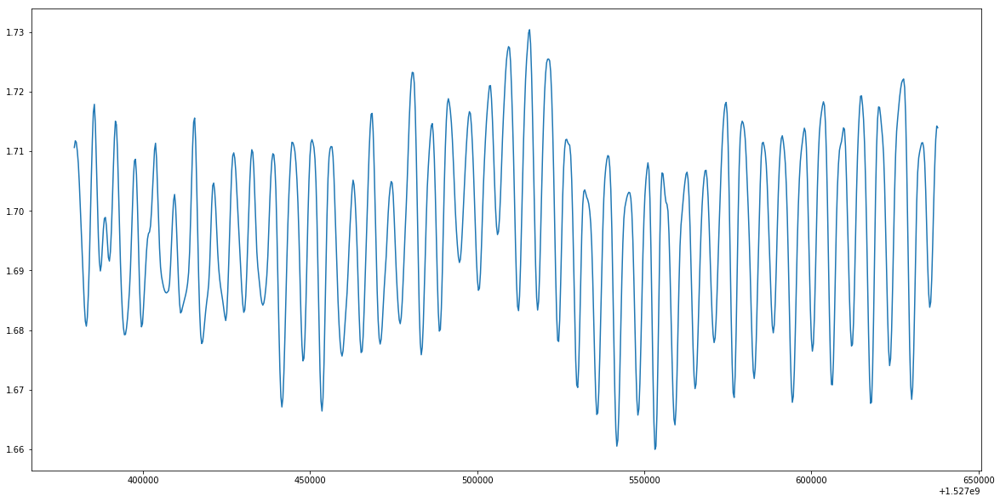

storybackupworker-preprod-4877eac77d
Cluster Label 1


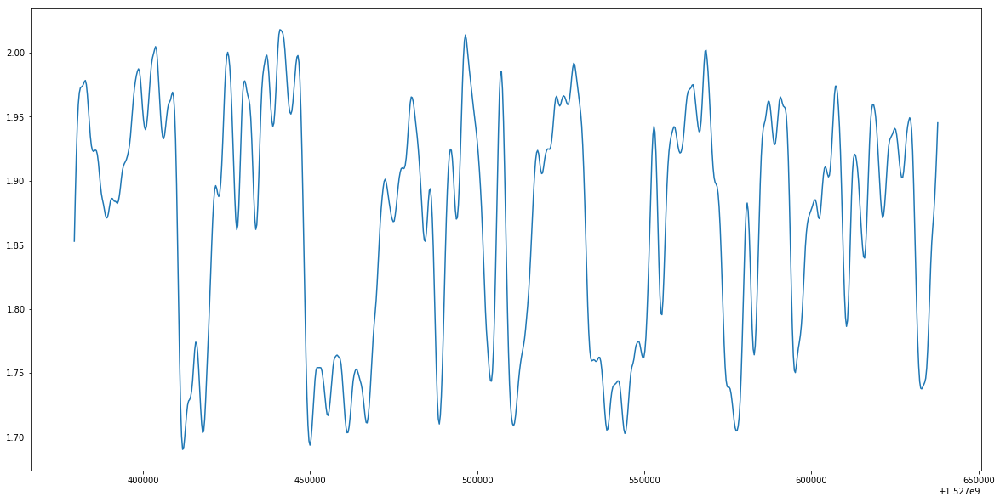

storybackupworker-preprod-edb529cad7
Cluster Label 1


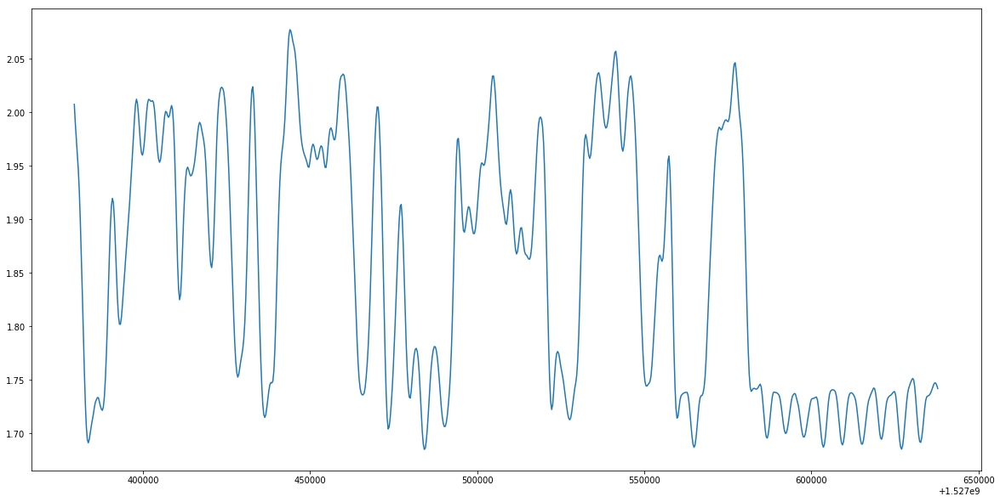

storybackupworker-production-0342c4aa02
Cluster Label 1


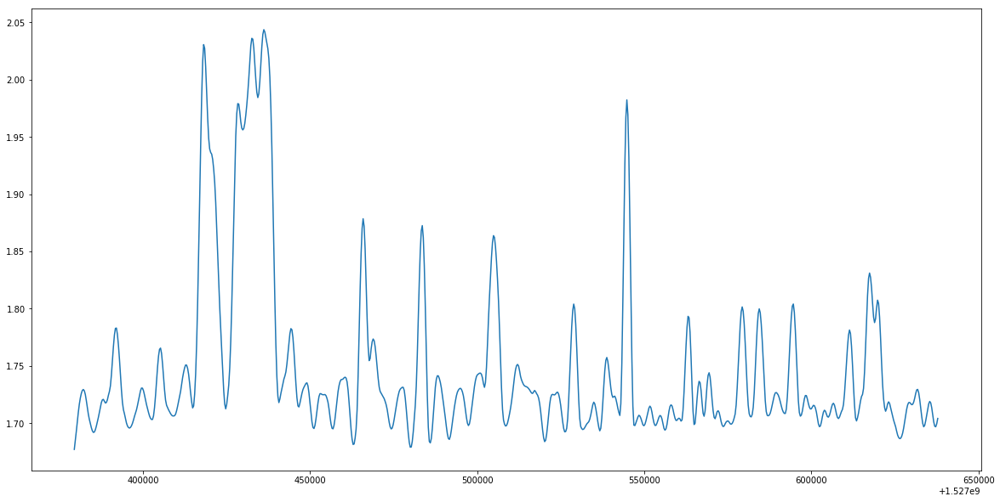

storybackupworker-production-755117c044
Cluster Label 1


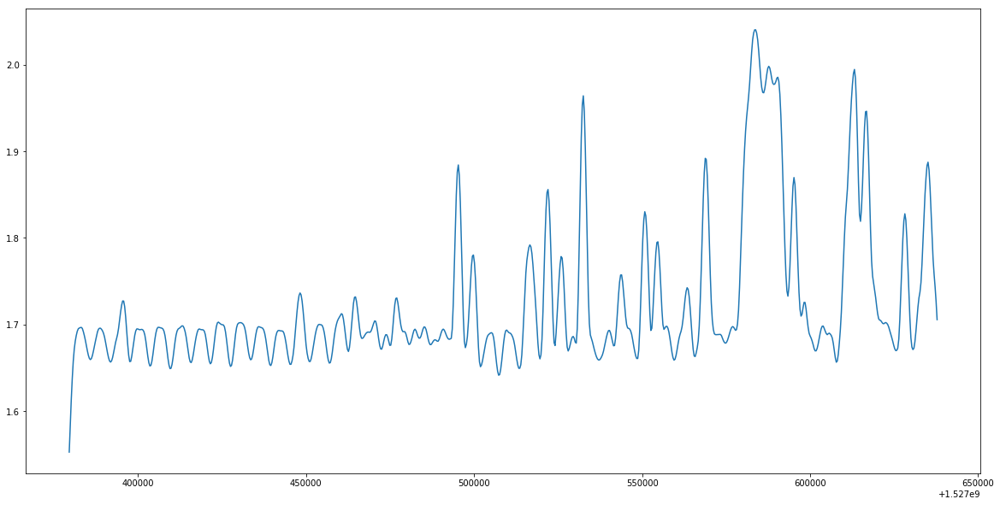

tps-prod-4069127799
Cluster Label 1


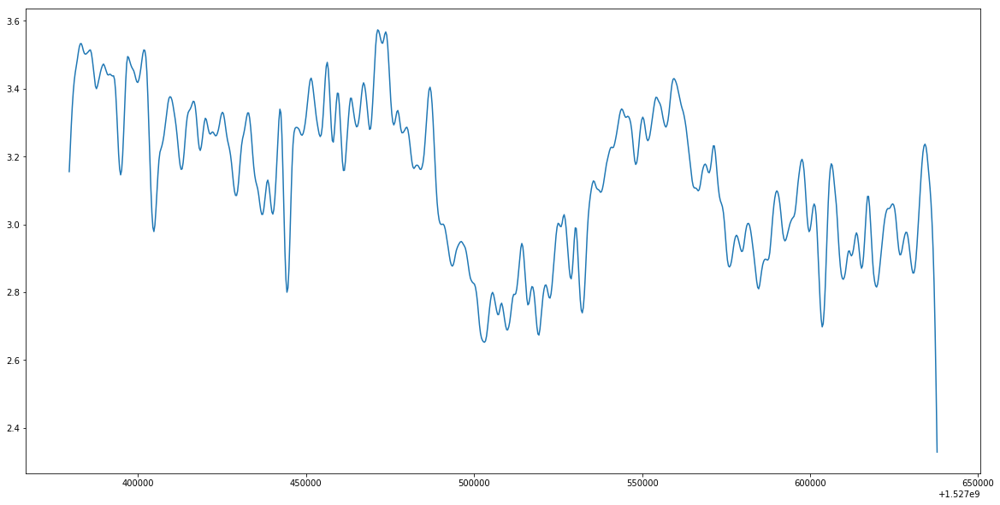

tslogger-prod-028e645d88
Cluster Label 1


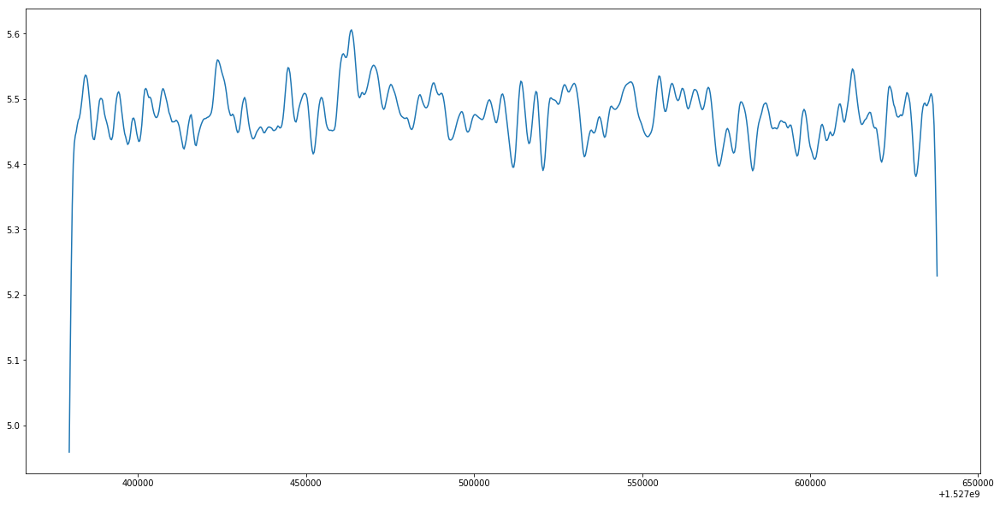

tsnormalizer-prod-2c19446dad
Cluster Label 1


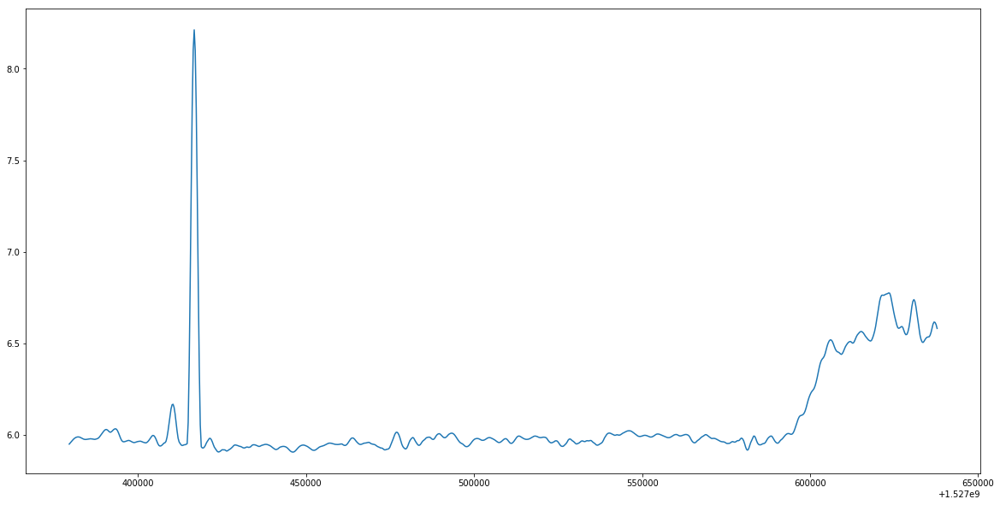

tsprospector-prod-e39192b952
Cluster Label 1


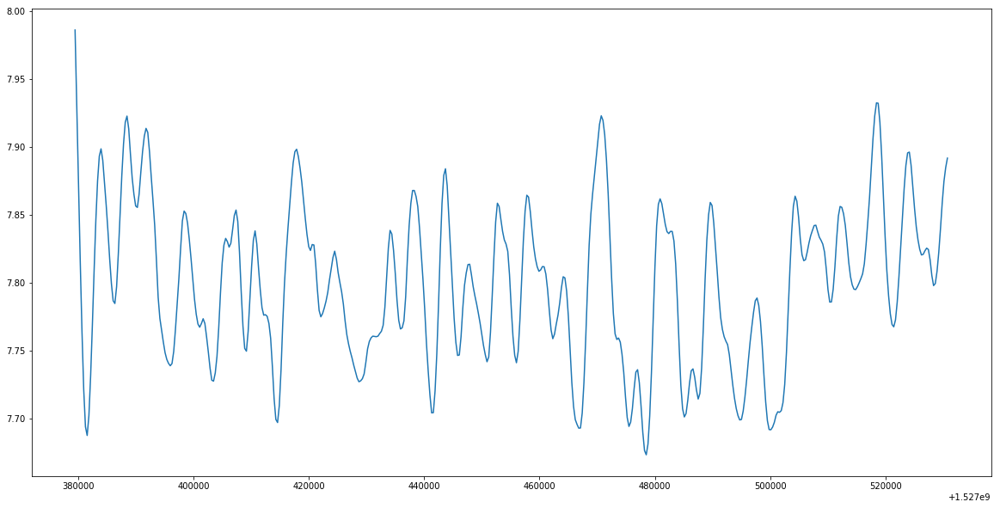

tsreport-prod-a4c944e2ae
Cluster Label 1


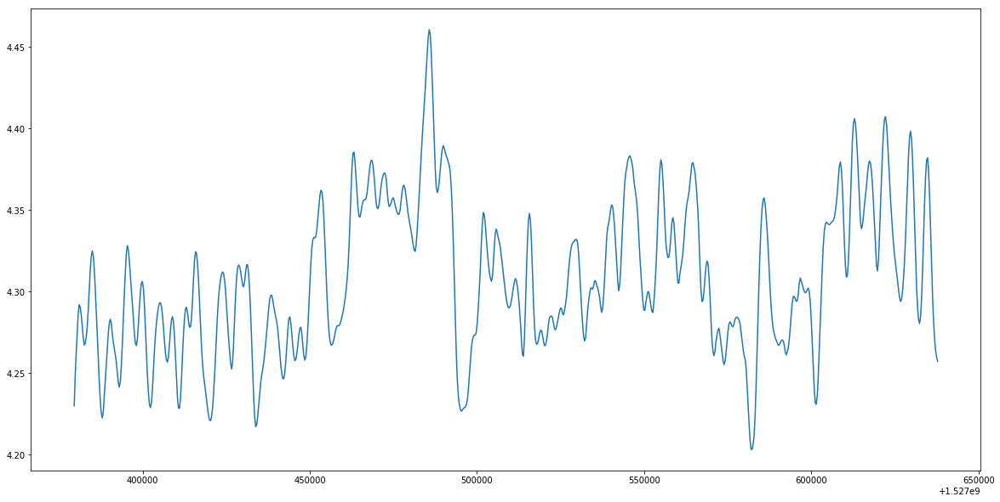

moveworker-production-87ea3d96de
Cluster Label 1


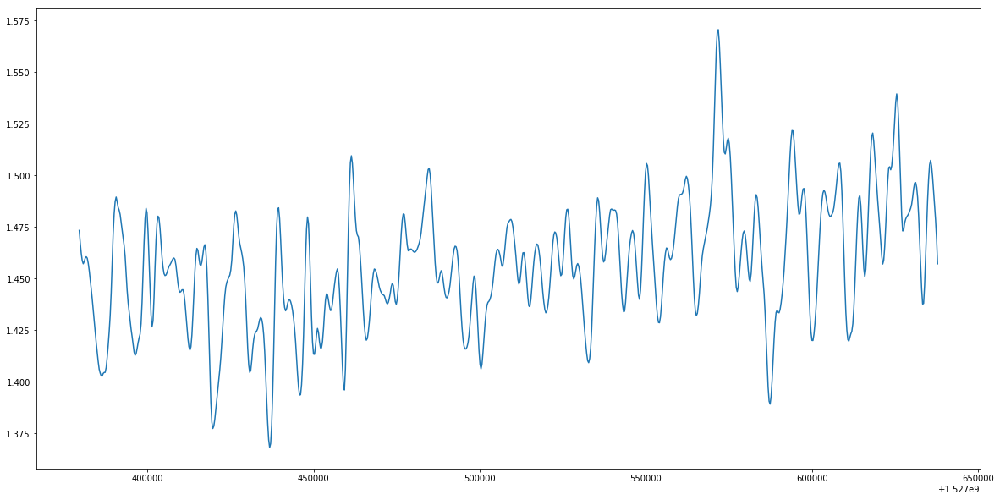

materialsservice-prod-9d558d95f4
Cluster Label 1


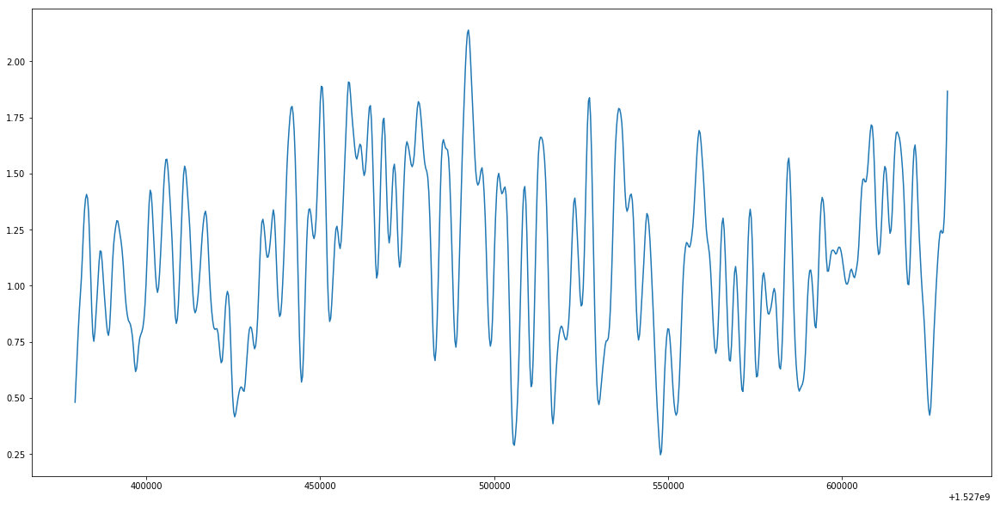

offers-prod-374f8f1744
Cluster Label 1


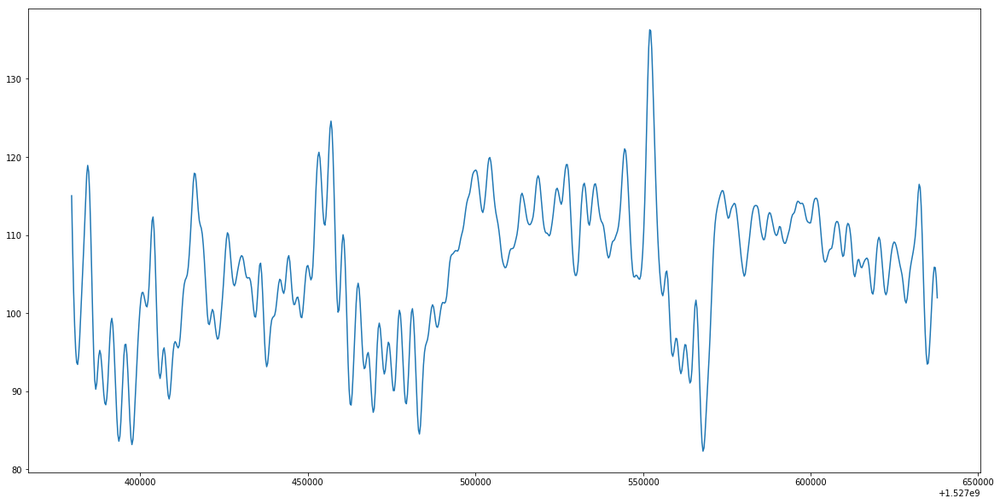

generictestworker-production-8dcb1a99c9
Cluster Label 1


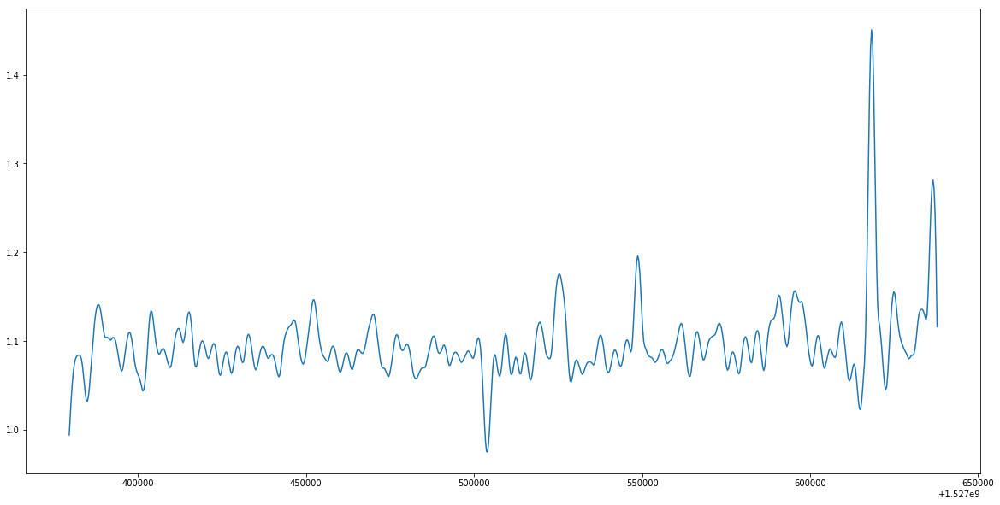

casclassifiercopyspace-prod-53401db761
Cluster Label 1


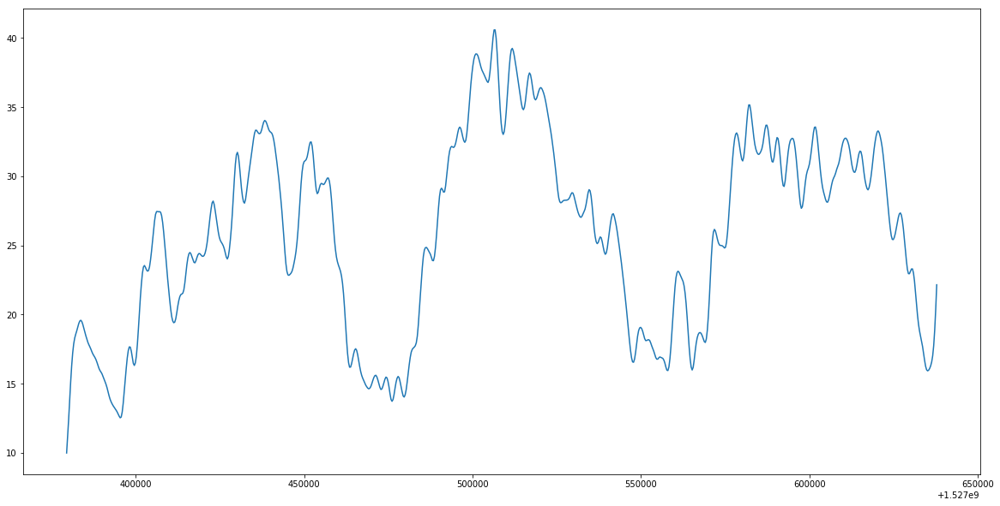

casfeatureaesthetic-prod-1ddb1ab615
Cluster Label 1


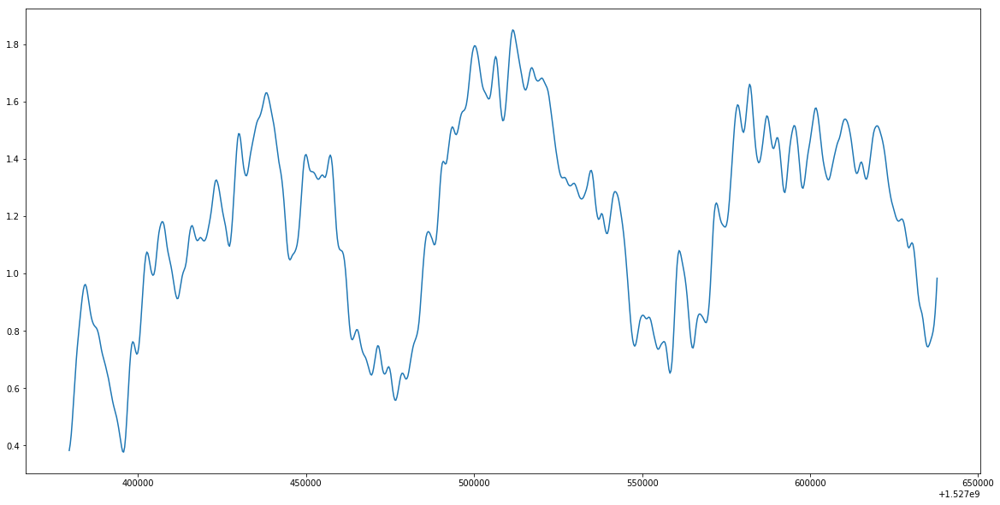

casfeatureaesthetic-prod-f505e14c13
Cluster Label 1


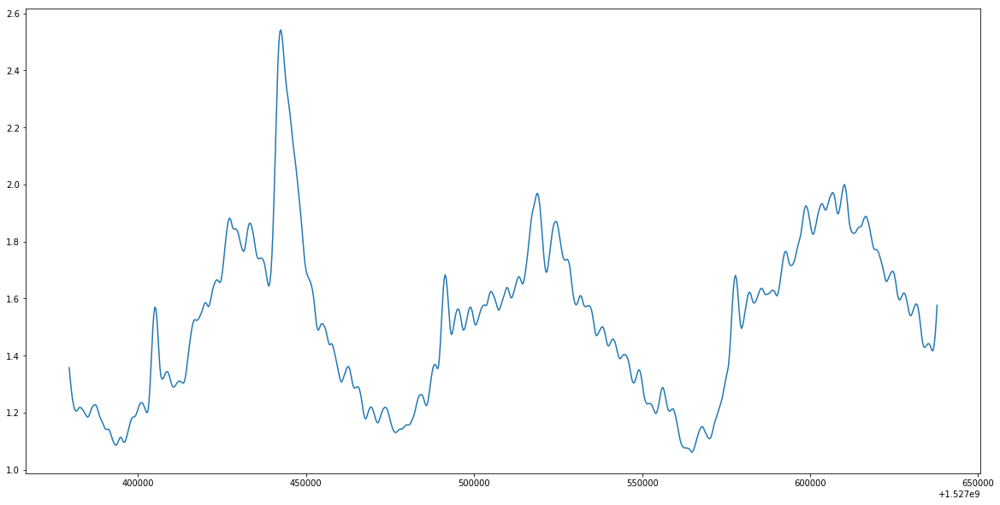

casfeaturestock3-prod-7c7d26425b
Cluster Label 1


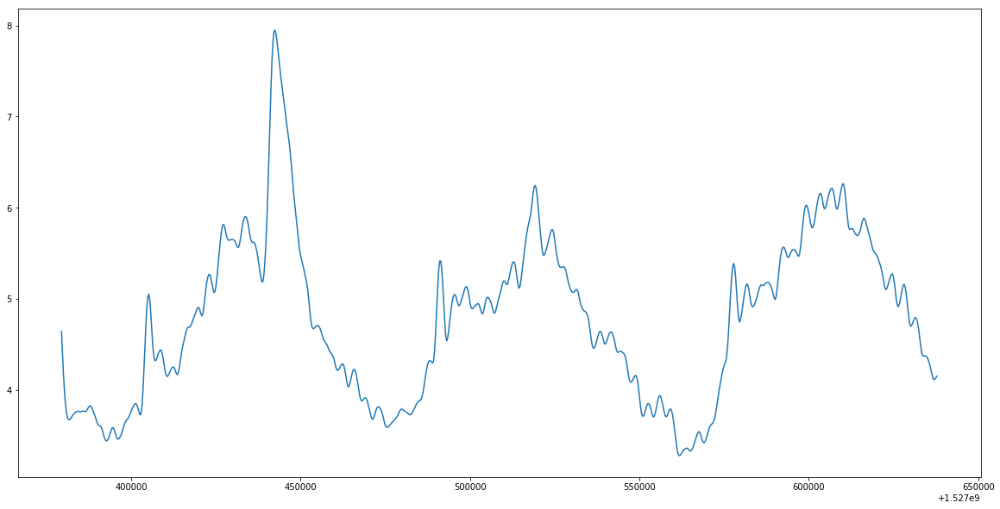

archivalworker-production-184dd1cf88
Cluster Label 1


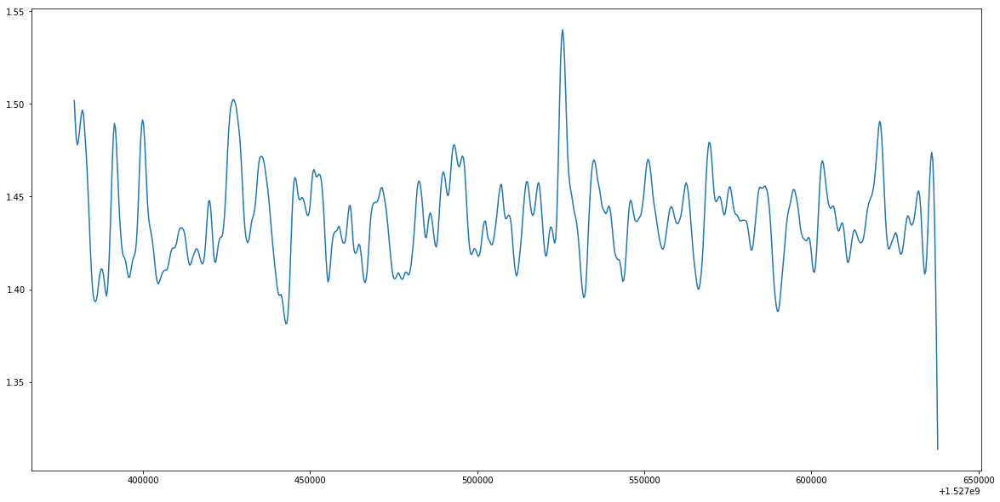

casfeaturestock7-prod-30df27e2ef
Cluster Label 1


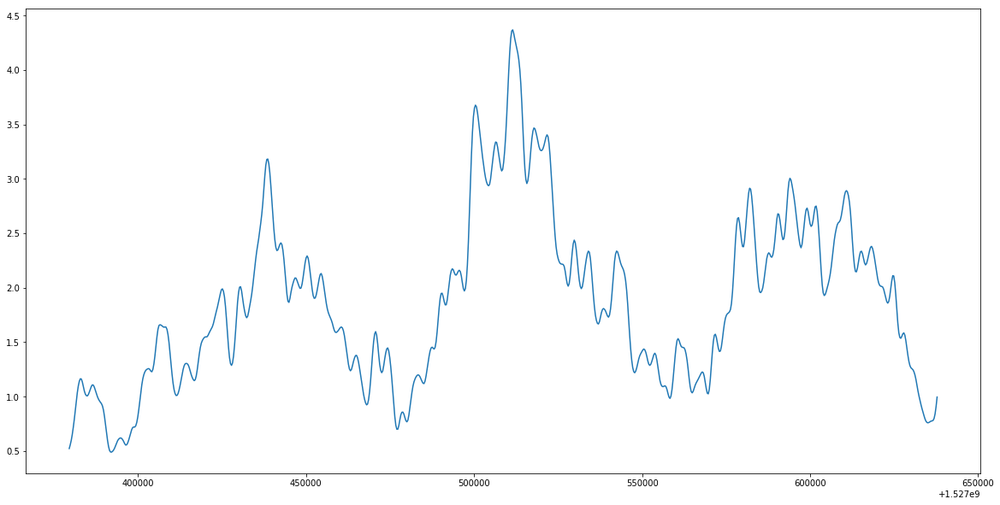

casfeaturestock7-prod-67febb021e
Cluster Label 1


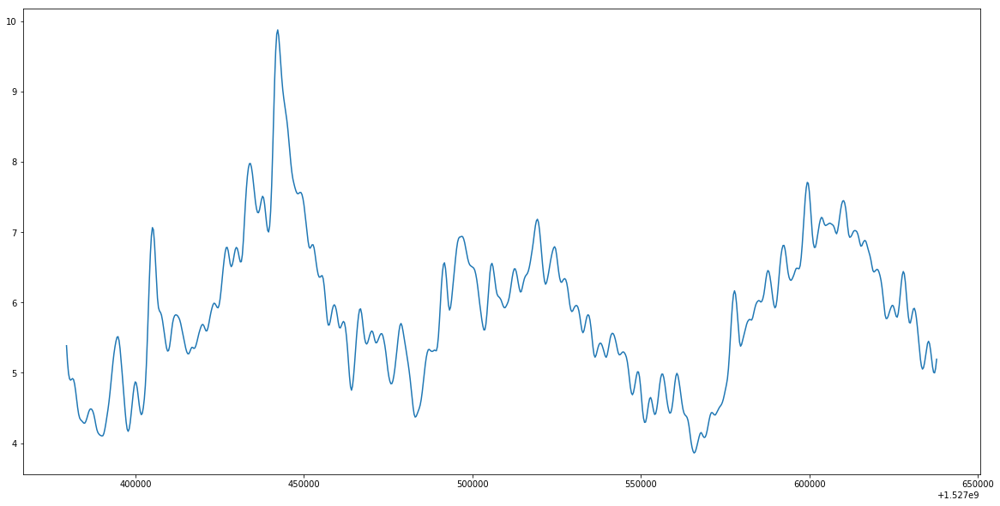

aos-production-83687b3fbc
Cluster Label 1


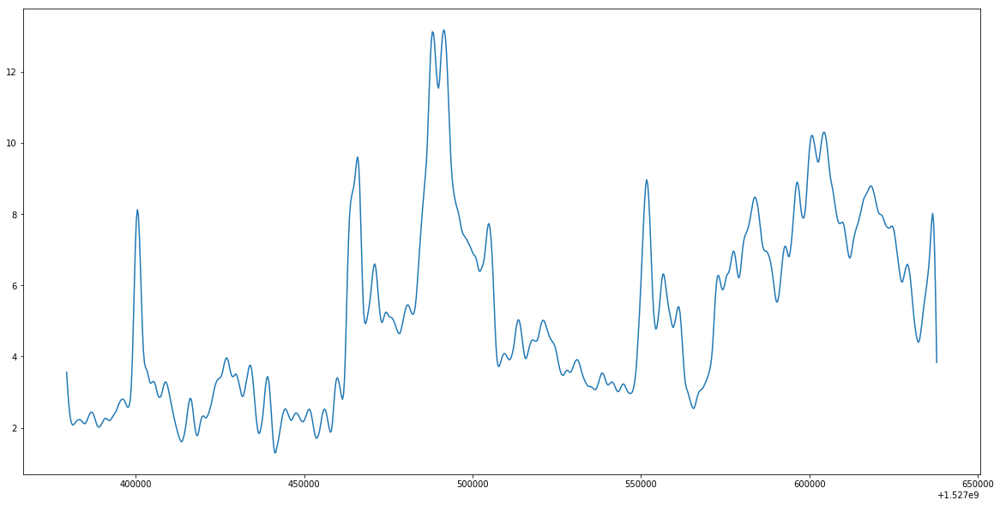

activitylogreceiver-prod-0bacf0ebf9
Cluster Label 1


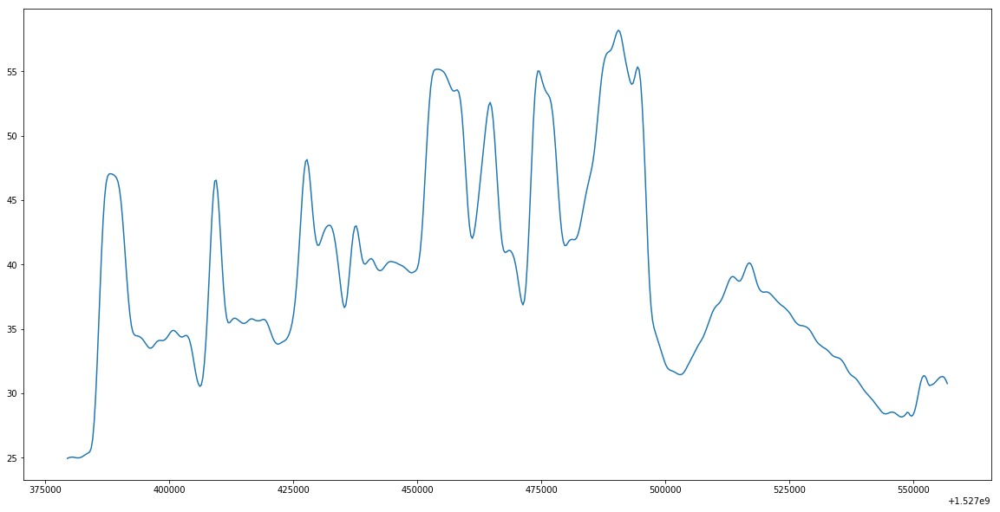

cclibraries-production-67331e1323
Cluster Label 1


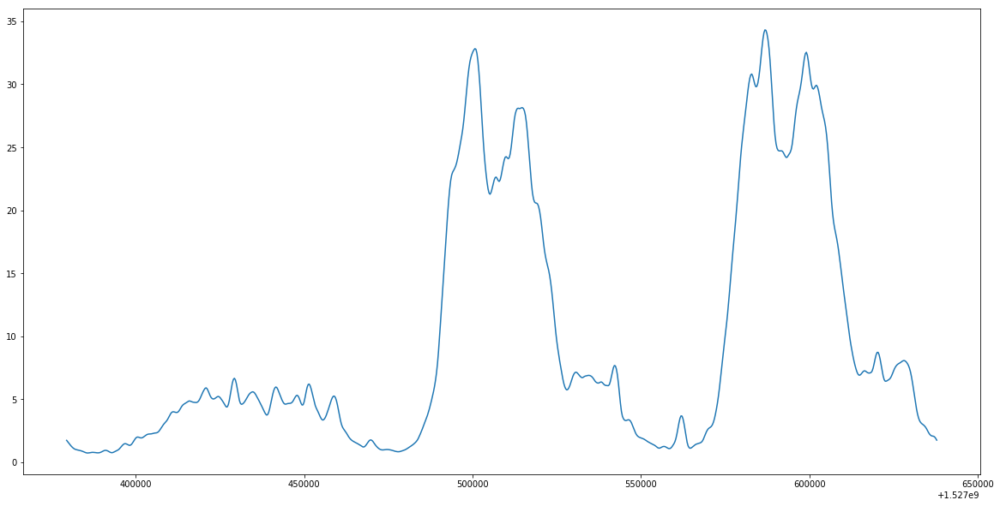

copyworker-production-dab2f3f0af
Cluster Label 1


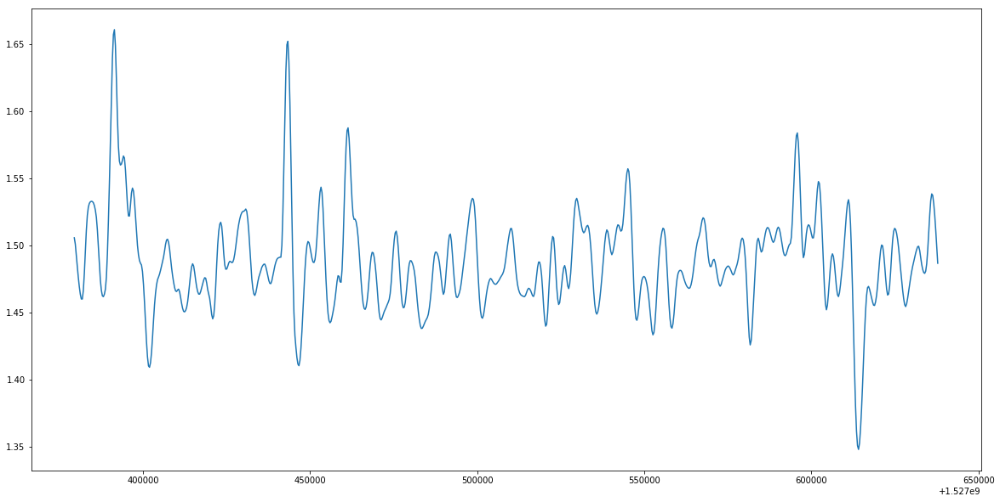

cupmat-prod-135779c869
Cluster Label 1


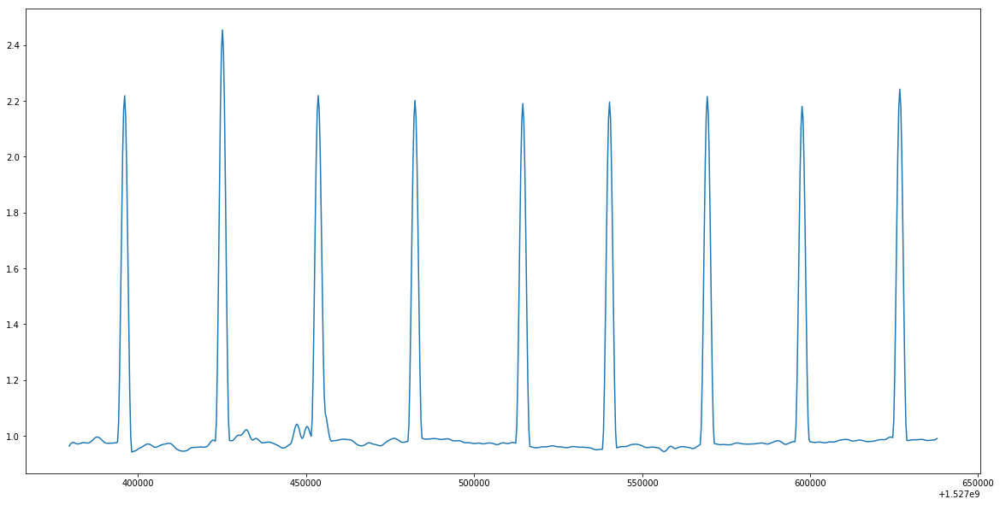

enterorgservice-prod-6f99c19a45
Cluster Label 1


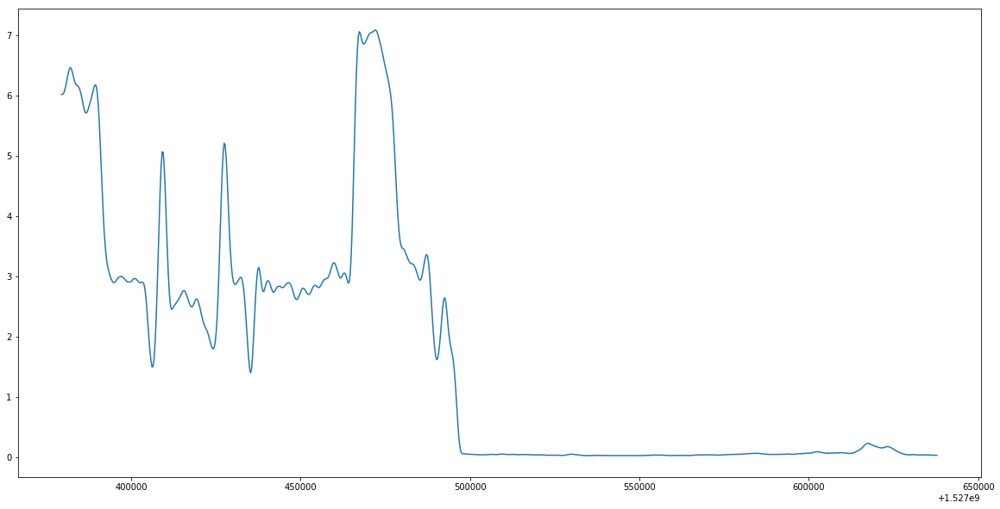

ethoscanarytest2-prod-a32ce355c7
Cluster Label 1


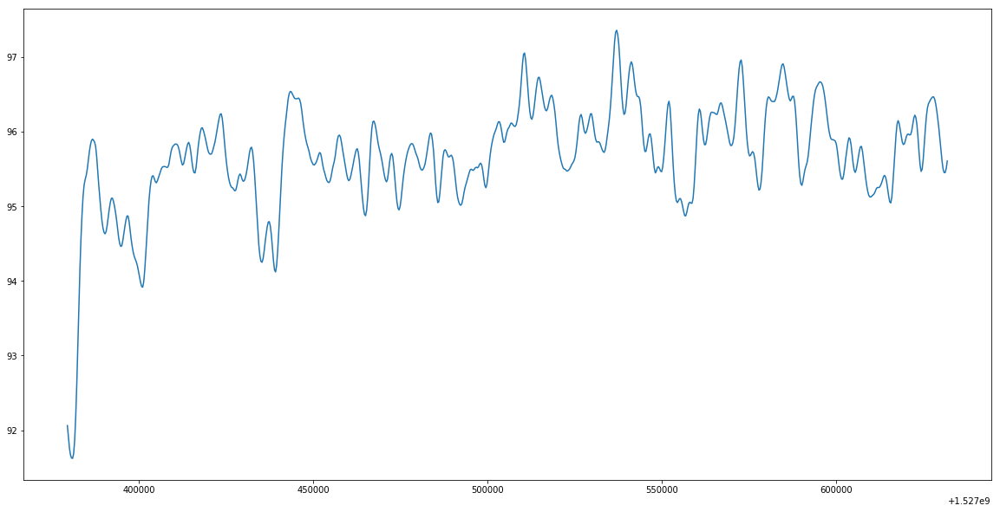

ethosha-production1-49f2add162
Cluster Label 1


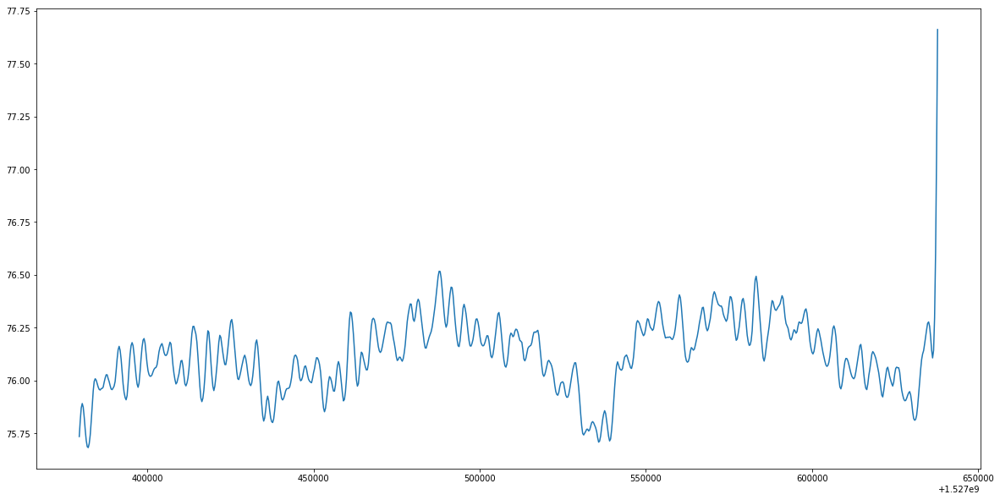

ethosha-production1-e06e9e0060
Cluster Label 1


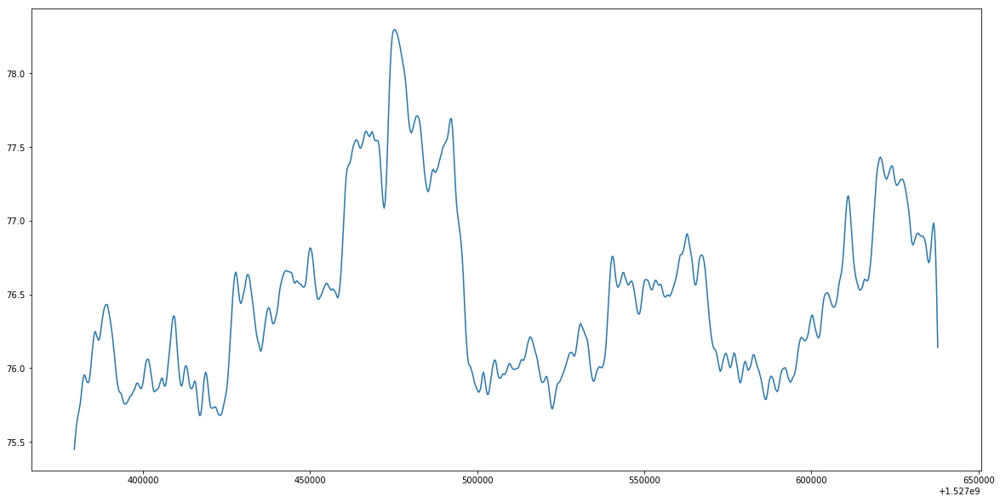

ethosha-production2-52f0276fa6
Cluster Label 1


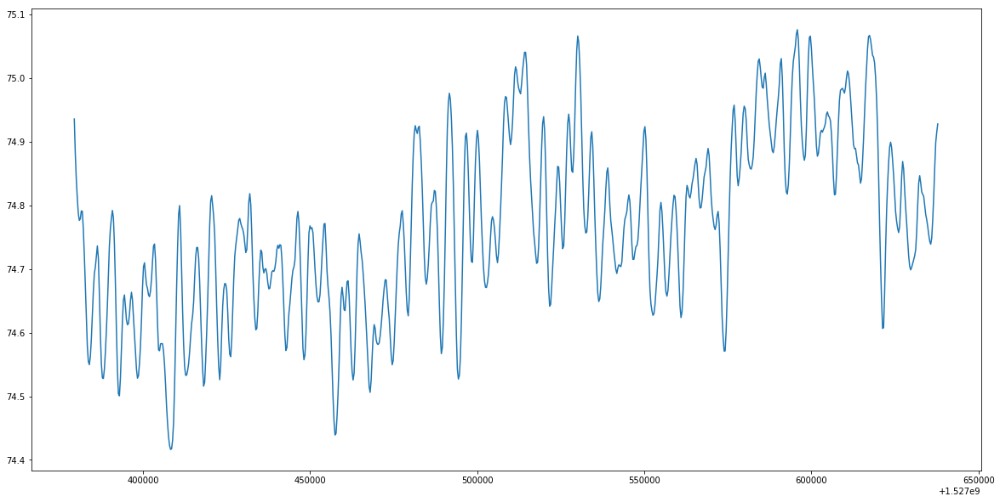

ethosha-production2-c343a08d41
Cluster Label 1


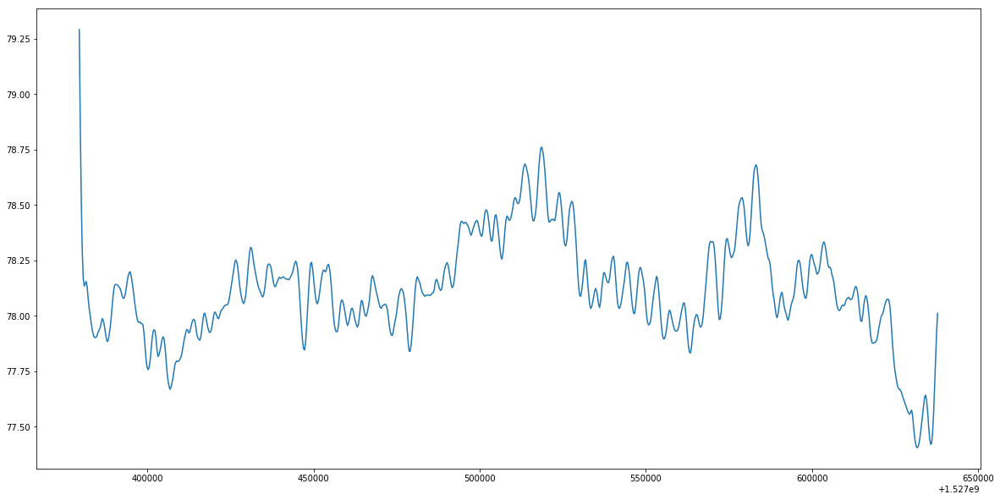

ethosha-production2-e1990b23d6
Cluster Label 1


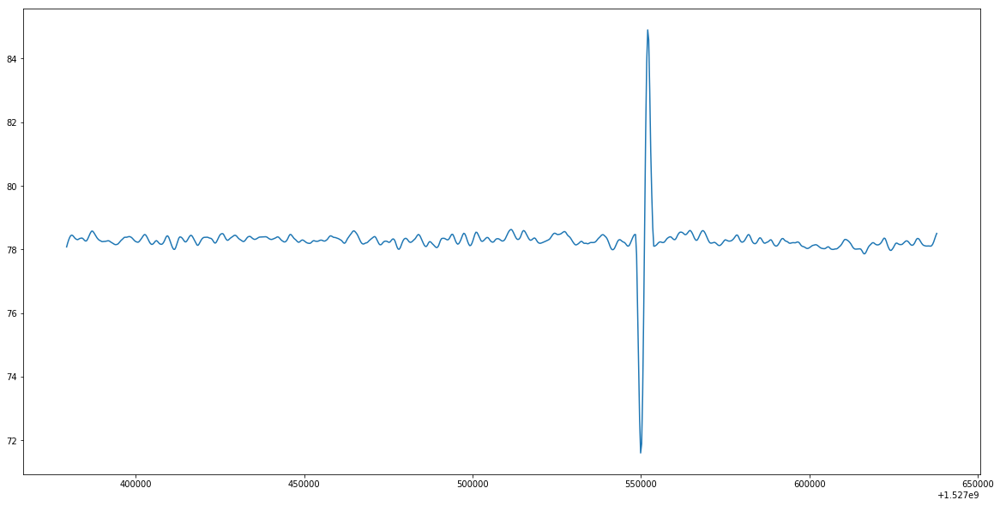

ethosha-production3-fb2c0465c9
Cluster Label 1


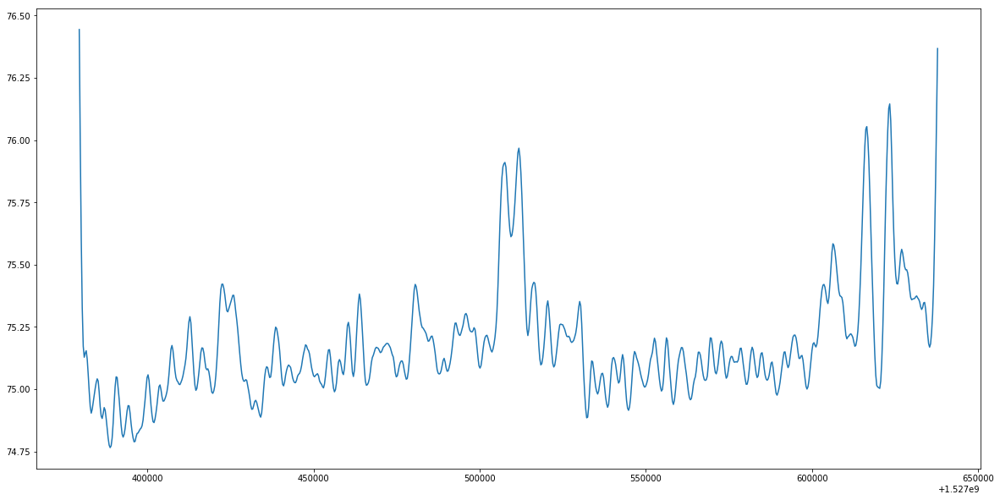

ethosha-production5-c5330f073d
Cluster Label 1


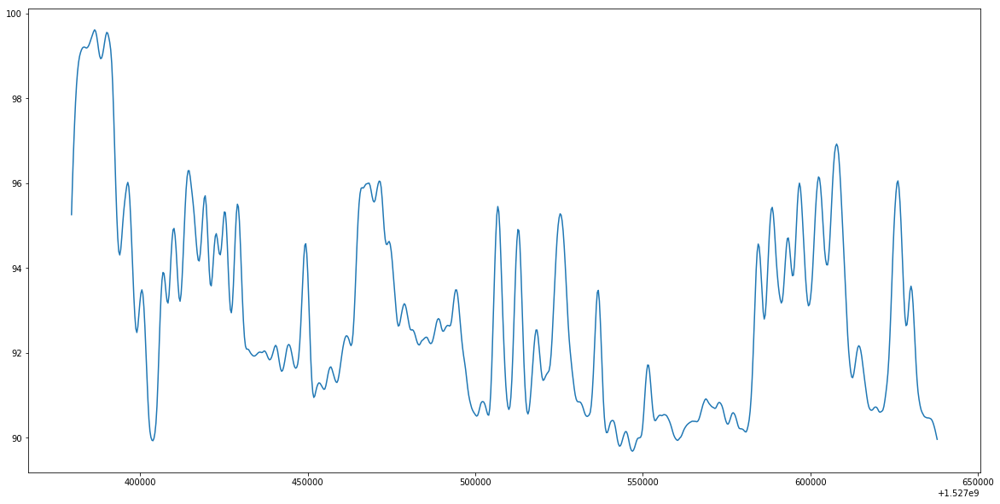

cupmat-production-632b434acd
Cluster Label 1


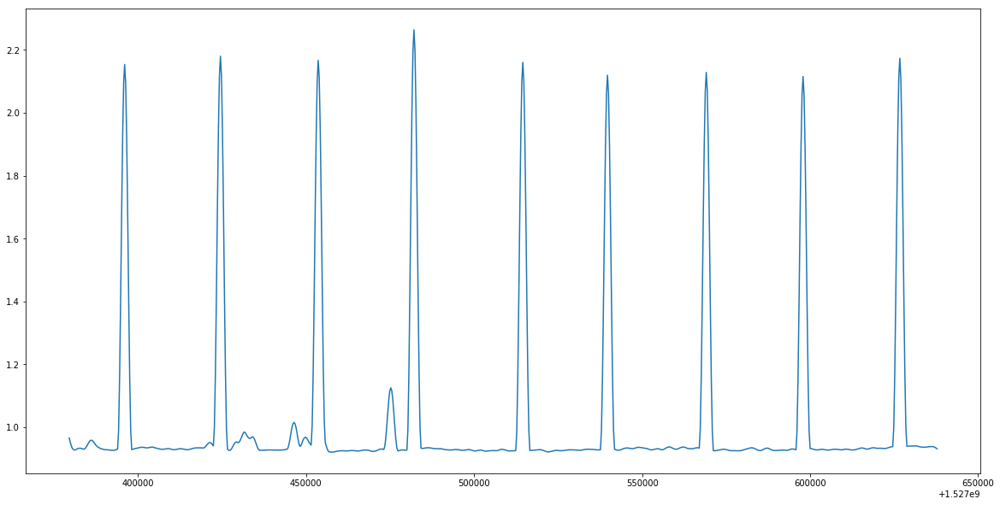

asradmin-production-beefcae400
Cluster Label 1


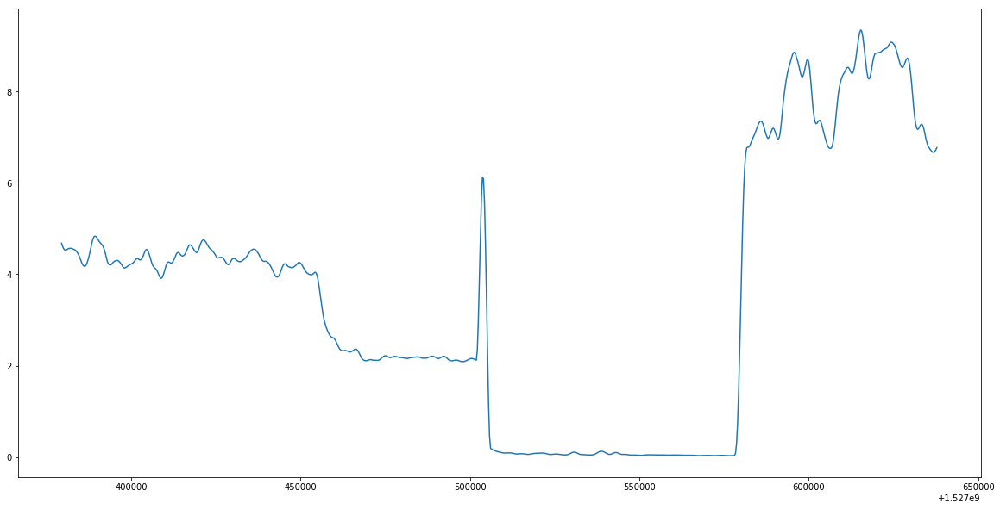

translator-production-ed3a5ad305
Cluster Label 2


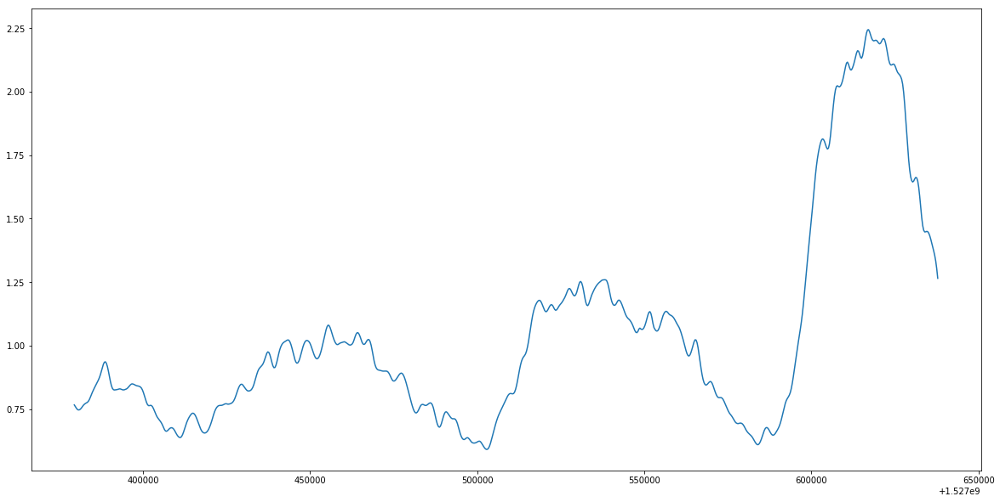

uss-prod-01d4080365
Cluster Label 2


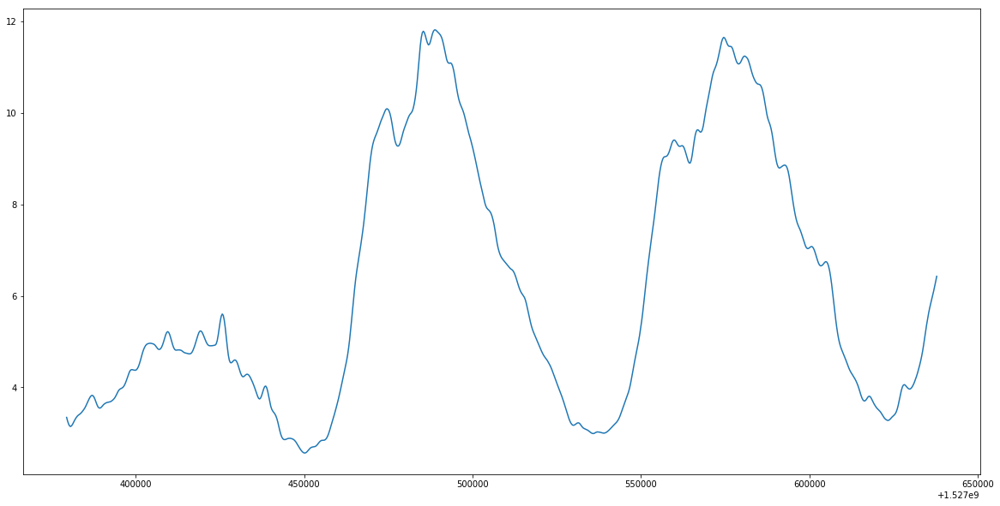

uss-prod-105178c1ac
Cluster Label 2


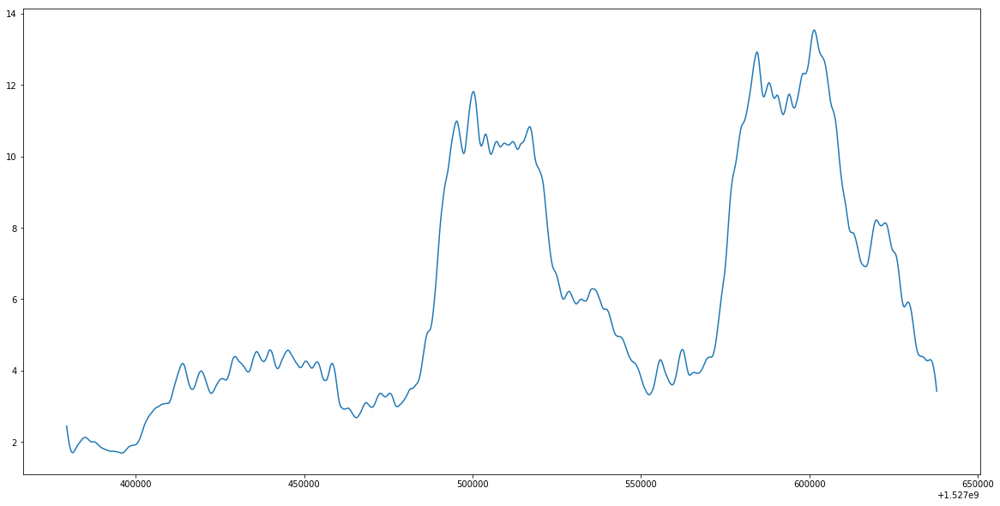

apex-production-eee88bd80a
Cluster Label 2


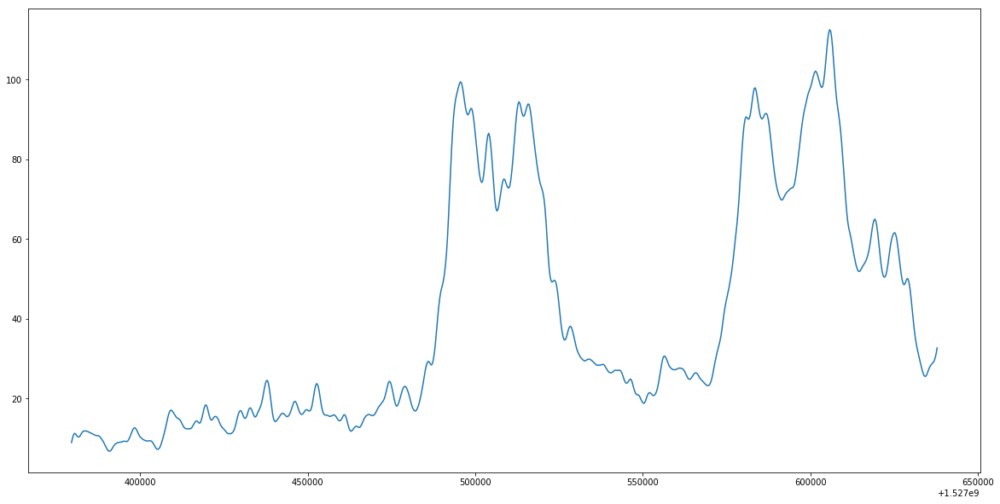

cchometrk-production-7582696fd2
Cluster Label 2


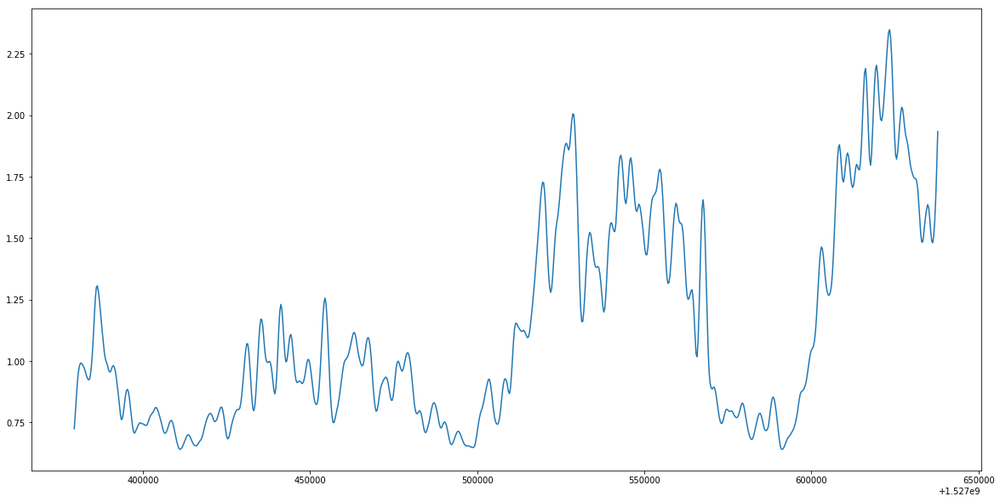

assets-production-3d37a9b1a1
Cluster Label 2


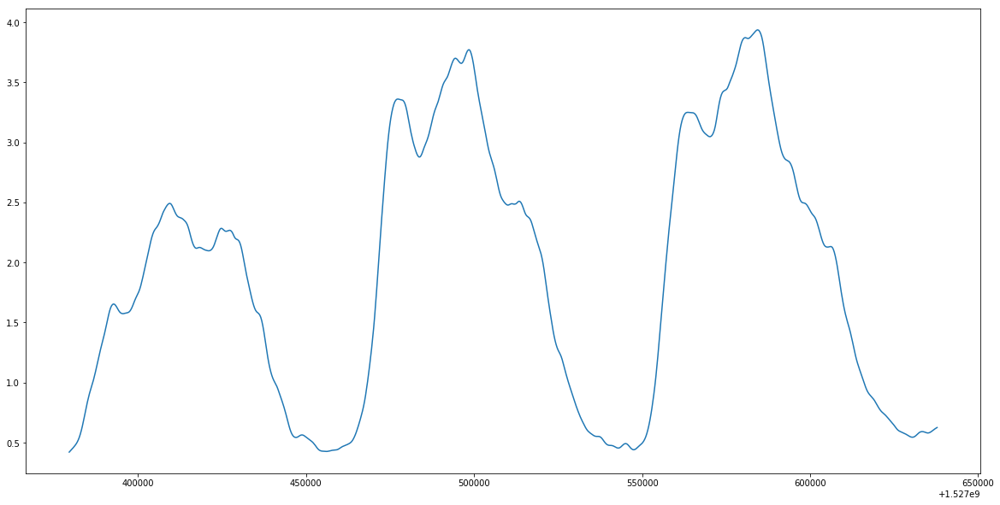

casfeaturestock3-prod-bbf01b89ba
Cluster Label 2


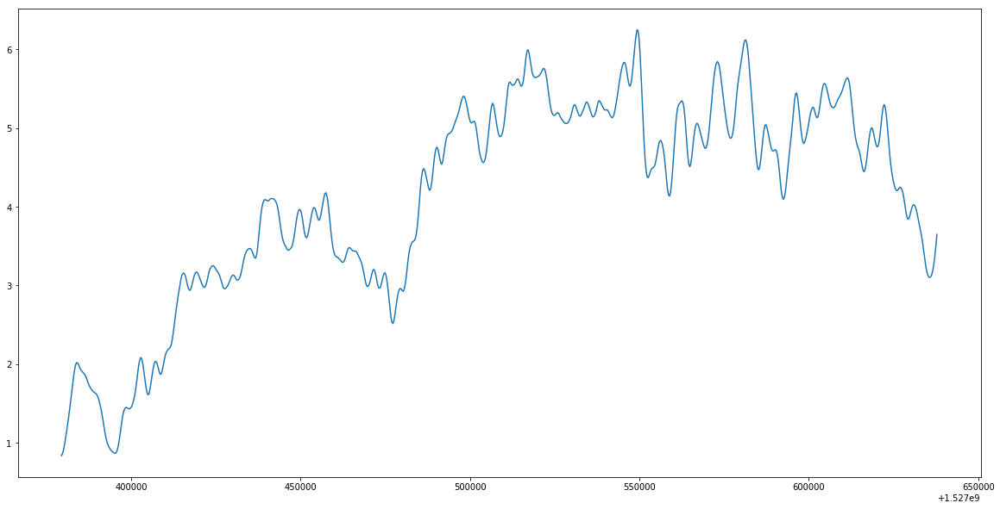

lridxsvc-production-94333b4209
Cluster Label 2


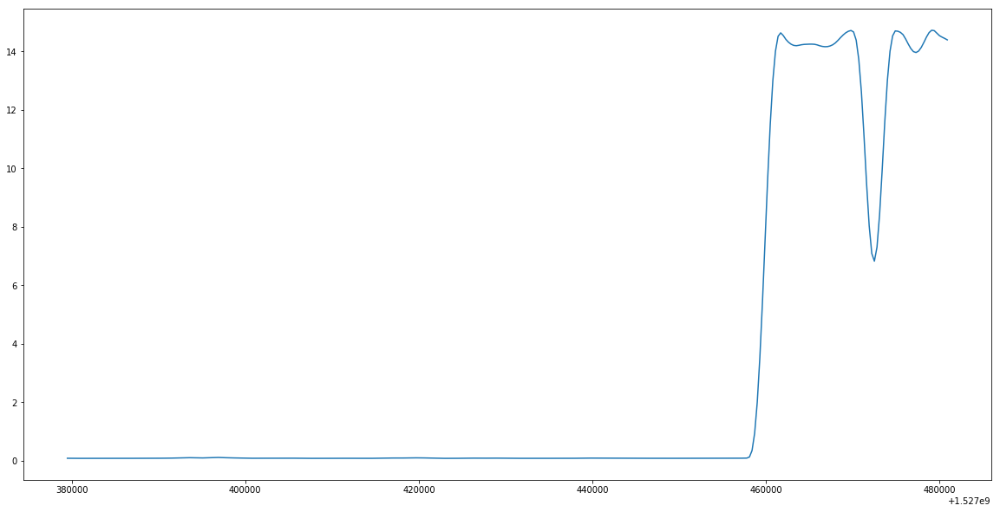

cclibraries-production-38f85ae50c
Cluster Label 2


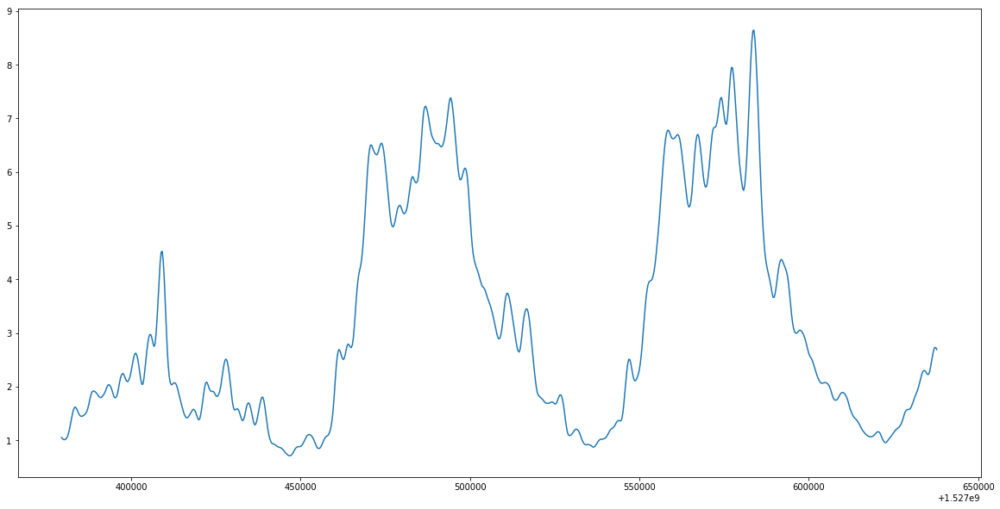

sophiacepservice-prod-0c6f493a8c
Cluster Label 2


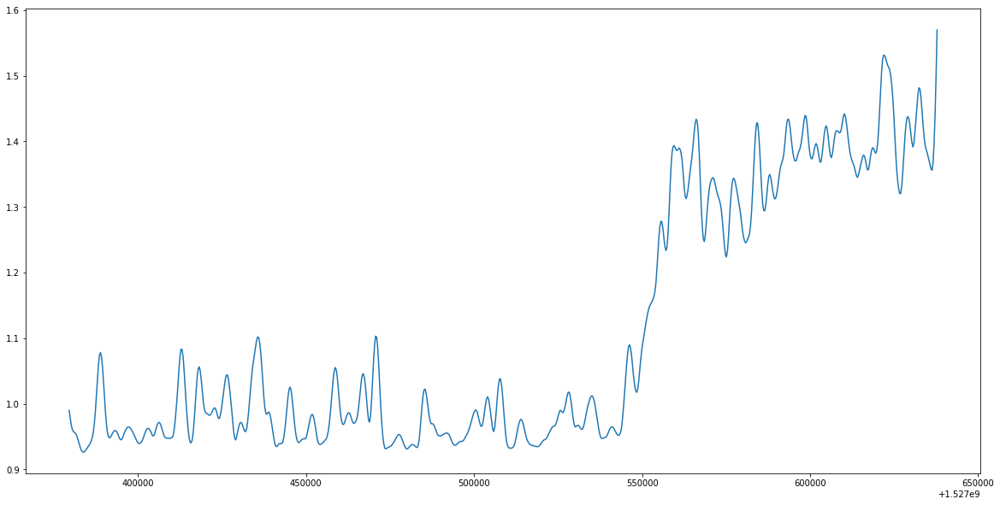

dooplo-prod-064f9c1650
Cluster Label 2


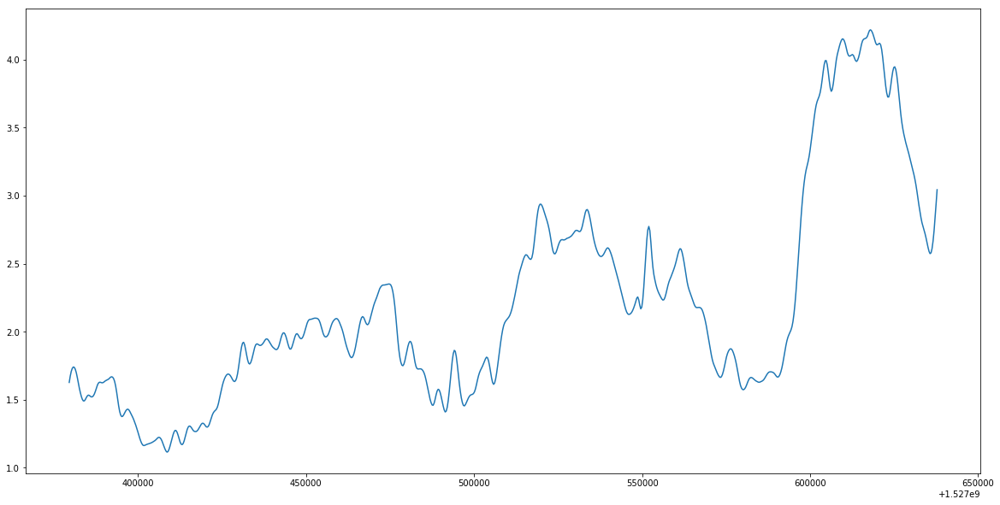

scidxsvc-production-36a1ff80c9
Cluster Label 2


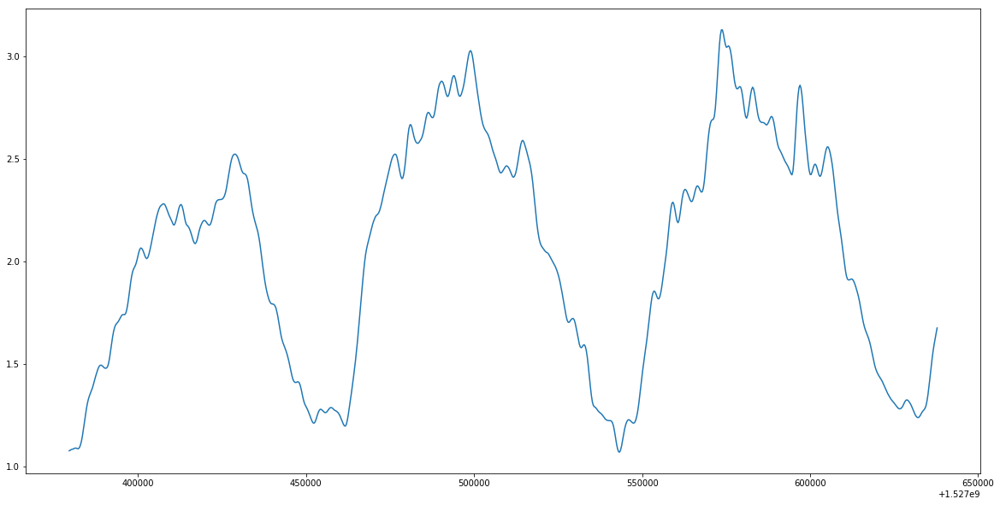

translator-production-2761721ab4
Cluster Label 2


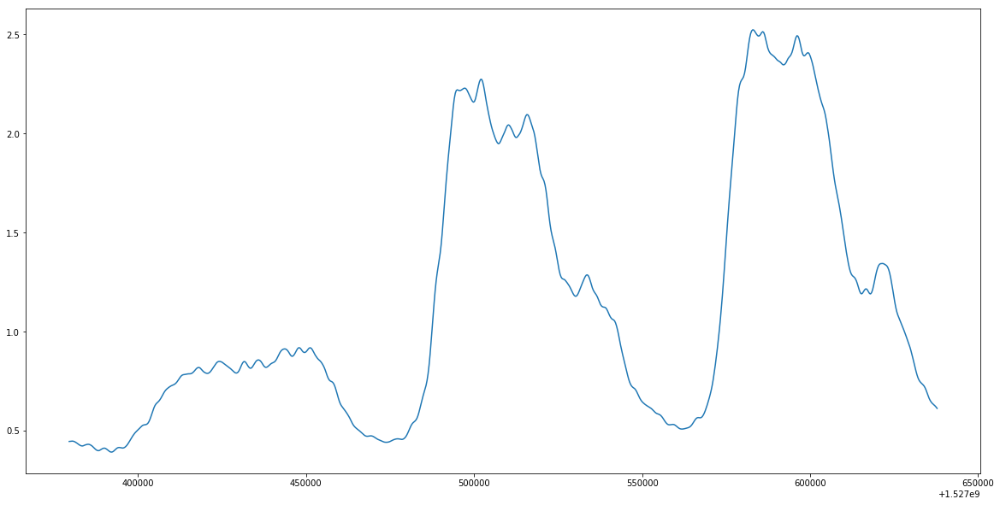

uss-prod2-c23944d098
Cluster Label 2


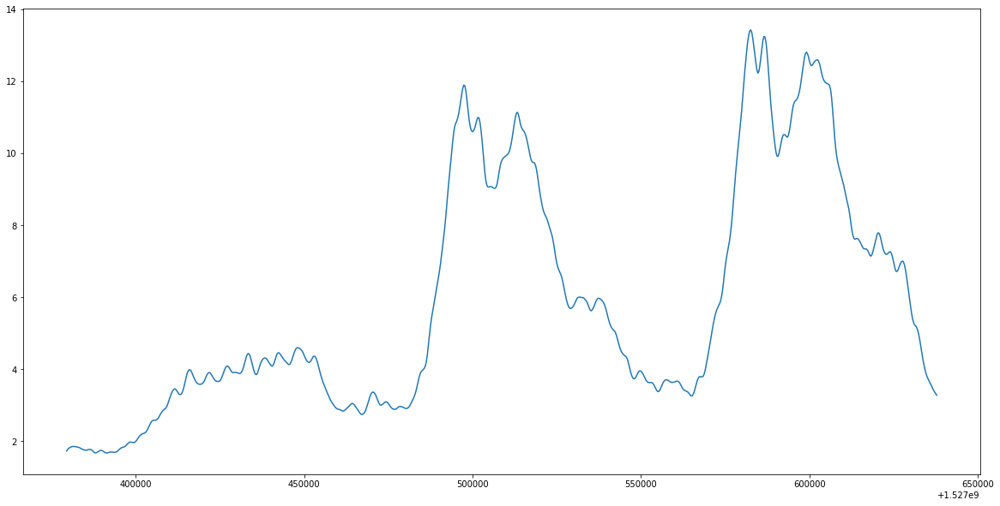

In [131]:
# plot the smoothed time series(unique service ids) cluster wise
import  pandas as pd
import os
for i in range(70):
    c=y_reduced['id'][i]
    t=pd.read_csv('/home/ubuntu/plots_smooth_less/'+c)
    print(c.split('.')[0])
    print('Cluster Label',y_reduced['cluster'][i])
    %matplotlib inline
    import matplotlib.pyplot as plt
    plt.figure(figsize=(20,10))
    plt.plot(t['node_timestamp'],t['utilization'])
    plt.show()
    

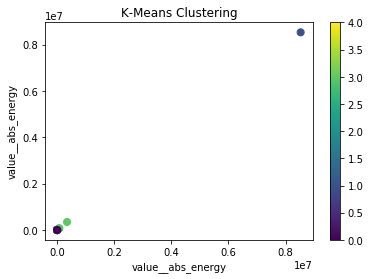

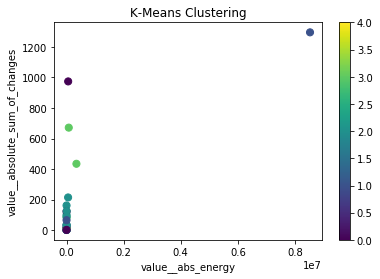

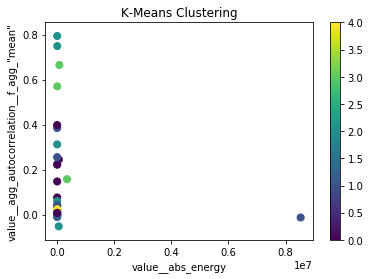

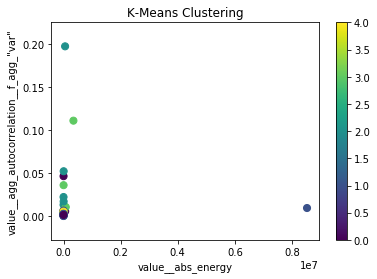

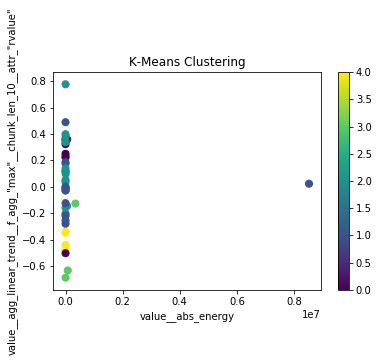

...

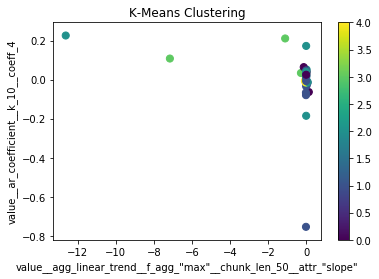

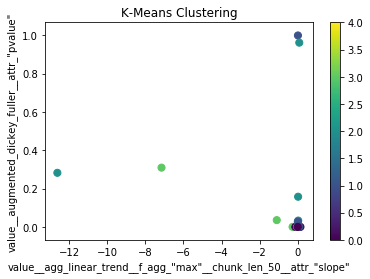

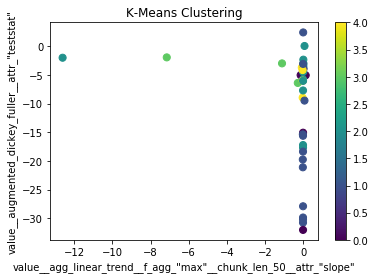

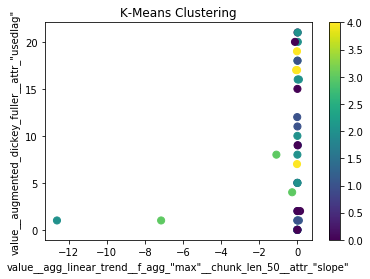

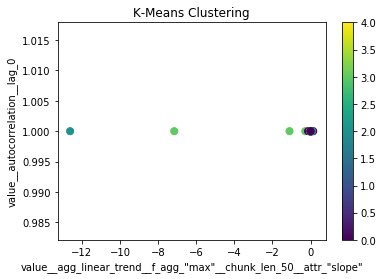

In [ ]:
# import matplotlib.pyplot as plt 
# #fig = plt.figure()
# #ax = fig.add_subplot(111)
# for idx,c1 in enumerate(y.columns[1:-1].tolist()):
#     for j in range(idx+1,len(y.columns[1:-1].tolist())):
        
#         %matplotlib inline
        
       
#         plt.scatter(y[c1],y[y.columns.tolist()[j]],c=kmeans[0],s=50)
#         plt.title('K-Means Clustering')
#         plt.xlabel(c1)
#         plt.ylabel(y.columns.tolist()[j])
#         plt.colorbar()
#         plt.show()